<a href="https://colab.research.google.com/github/AnnaVitali/plantRecognition/blob/master/plantRecognition_featureHandCrafted.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Riconoscimento delle piante
Il problema che si vuole andare a risolvere, in questo caso, è di riuscire a identificare le diverse tipologie di piante, a partire da una foto della loro foglia. 

Per il processo di riconoscimento si è deciso di utilizzare delle feature hand-crafted.

## Download training set

url del dataset di riferimento: https://www.kaggle.com/datasets/vipoooool/new-plant-diseases-dataset

In [ ]:
!pip install -q kaggle
from google.colab import files
files.upload()
!mkdir ~/.kaggle 
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets list
!kaggle datasets download -d vipoooool/new-plant-diseases-dataset

Saving kaggle.json to kaggle.json
ref                                                             title                                               size  lastUpdated          downloadCount  voteCount  usabilityRating  
--------------------------------------------------------------  -------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
ahsan81/hotel-reservations-classification-dataset               Hotel Reservations Dataset                         480KB  2023-01-04 12:50:31           8712        300  1.0              
googleai/musiccaps                                              MusicCaps                                          793KB  2023-01-25 09:25:48           1688        177  0.9411765        
themrityunjaypathak/most-subscribed-1000-youtube-channels       Most Subscribed 1000 Youtube Channels               28KB  2023-01-21 14:42:05           2145         70  1.0              
nitishsharma01/olympics-124-yea

In [ ]:
! unzip new-plant-diseases-dataset.zip

## Import

In [ ]:
import os
import glob
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import random
import shutil
from PIL import Image
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from ipywidgets import interact, fixed
import ipywidgets as widgets

## Utilities

In [ ]:
class_names = ['Apple', 'Blueberry', 'Cherry', 'Corn', 'Grape', 'Orange', 'Peach', 'Pepper,', 'Potato', 'Raspberry', 'Soybean', 'Squash', 'Strawberry', 'Tomato']

def load_data(data_folder_path):
    image_list=[]
    label_list=[]
    class_folder_path_list=glob.glob(data_folder_path+'/*/')
    for class_folder_path in class_folder_path_list:
        class_folder_path=class_folder_path.replace('\\','/')
        folder_label=os.path.basename(class_folder_path.split("_")[0])

        for image_file_path in glob.glob(class_folder_path+'/*'):
            image_file_path=image_file_path.replace('\\','/')
            image=Image.open(image_file_path)
            image = np.asarray(image)[:,:,:3]
            image = cv2.resize(image, (64, 64), interpolation = cv2.INTER_LINEAR)
            image_list.append(image)
            label_list.append(class_names.index(folder_label))

    return np.asarray(image_list),np.asarray(label_list)


def show_images(index, images):
  rows = 3
  columns = 5
  plt.rcParams.update({'font.size': 20})
  _, axs = plt.subplots(rows, columns, squeeze=False, figsize=(20, 10))

  for i in range(rows*columns):
    r = i // columns
    c = i % columns
    axs[r, c].axis('off')
    axs[r, c].imshow(images[i])
    axs[r, c].set_title(class_names[train_y[index[i]]], fontsize = 16)


## Caricamento dataset
- il dataset contiene in tutto 87K immagini RGB di foglie con malattie e sane riferite, a 14 diverse tipologie di piante;

- è diviso secondo un rapporto 80/20 in dati del training set e dati del test set;

- le diverse immagini sono raggruppate in cartelle per le classi corrispondenti.

In [ ]:
db_path_train = '/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train'
db_path_valid = '/content/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid'

train_x, train_y = load_data(db_path_train)
valid_x, valid_y = load_data(db_path_valid)


print('Shape training set: {}'.format(train_x.shape))
print('Shape validation set: {}'.format(valid_x.shape))

Shape training set: (70295, 64, 64, 3)
Shape validation set: (17572, 64, 64, 3)


## Visualizzazione immagini

Le classi del problema considerato sono 14: Apple, Blueberry, Cherry, Corn, Grape, Orange, Peach, Pepper, Potato, Raspberry, Soybean, Squash, Strawberrry e Tomato.

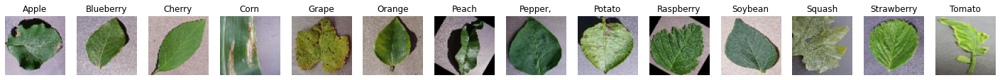

In [ ]:
_, axs = plt.subplots(1, len(class_names),figsize=(25, 25))
for i in range(len(class_names)):
  train_class_pos=np.where(train_y==i)
  rnd_idx=random.randint(0,len(train_class_pos[0]))
  p=train_class_pos[0][rnd_idx]
  axs[i].imshow(train_x[p]),axs[i].axis('off'),axs[i].set_title(class_names[train_y[p]])

## Estrazione delle feature

Per poter risolvere il porblema di classificazione, si è partiti cercando di capire quali fossero le feature più rappresentative che meglio consentissero una discriminazione fra le diverse classi.

Si è partiti cercando di classificare una sola immagine del validation set, valutando i diversi risultati ottenuti per le diverse feature.

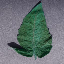

Tomato


In [ ]:
image_to_retrieve = 15
true_index = random.randint(0,len(valid_x))
query = valid_x[true_index]

cv2_imshow(query)
print(class_names[valid_y[true_index]])

### Feature di forma

La prima feature che abbiamo estratto è la feature di forma
- un aspetto che salta subito all'occhio osservando le diverse foglie è che presentano forme differenti, in grado di distinguerle.

- Per poter estrarre le feature di forma abbiamo: 
 - calcolato la rappresentazione HSV dell'immagine; 
 - tarato i parametri di questo spazio, per formulare una maschera binaria che racchiudesse l'informazione della forma dell'oggetto;
 - applicato alla maschera binaria ottenuta, un'operazione di chiusura morfologica per riempire eventuali buchi nella forma della foglia.

- L'efficacia di questo approcio è anche stata determinata dal fatto che:
 - le foglie presentano circa le stesse tonalità di colore;
 - il background nella maggior parte delle immagini presenta caratteristiche uniformi.

In [ ]:
w_h_range=widgets.IntRangeSlider(description='Range H:',min=0,max=255,value=(49,104), step=1,continuous_update=False)
w_s_range=widgets.IntRangeSlider(description='Range S:',min=0,max=255,value=(19,255), step=1,continuous_update=False)
w_v_range=widgets.IntRangeSlider(description='Range V:',min=0,max=255,value=(0,255), step=1,continuous_update=False)

hsv = cv2.cvtColor(query,cv2.COLOR_BGR2HSV)
@interact(hsv=fixed(hsv),h_range=w_h_range,s_range=w_s_range,v_range=w_v_range)
def interactive_masked_roi(hsv, h_range,s_range,v_range):
  mask = cv2.inRange(hsv, (h_range[0],s_range[0],v_range[0]), (h_range[1],s_range[1],v_range[1]))
  cv2_imshow(mask)

interactive(children=(IntRangeSlider(value=(49, 104), continuous_update=False, description='Range H:', max=255…

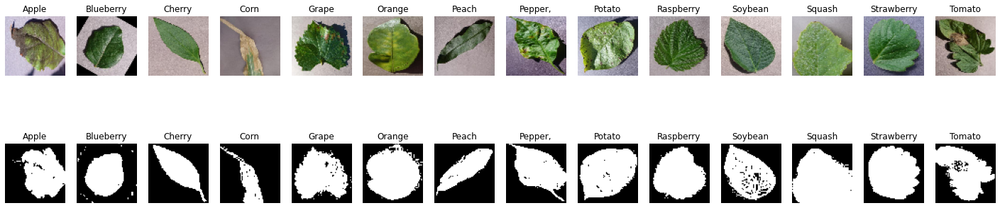

In [ ]:
_, axs = plt.subplots(2, len(class_names),figsize=(25, 25))
plt.subplots_adjust(bottom=0.5, top=0.7, hspace=0)
for i in range(len(class_names)):
  train_class_pos=np.where(train_y==i)
  rnd_idx=random.randint(0,len(train_class_pos[0]))
  p=train_class_pos[0][rnd_idx]
  img = train_x[p]

  
  # convert to hsv
  hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)

  # threshold using inRange
  h_min_value=49  #w_h_range.value[0]
  h_max_value=104 #w_h_range.value[1]
  s_min_value=19 #w_s_range.value[0]
  s_max_value=255 #w_s_range.value[1]
  v_min_value=0 #w_v_range.value[0]
  v_max_value=255 #w_v_range.value[1]

  lower_bound = np.array([h_min_value, s_min_value, v_min_value])
  upper_bound = np.array([h_max_value, s_max_value, v_max_value])

  mask = cv2.inRange(hsv,lower_bound,upper_bound)
  sm = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((1,1), np.uint8))
 
  axs[0,i].imshow(img, cmap='gray'),axs[0, i].axis('off'),axs[0, i].set_title(class_names[train_y[p]])
  axs[1,i].imshow(sm, cmap='gray'),axs[1, i].axis('off'),axs[1, i].set_title(class_names[train_y[p]])

In [ ]:
from tensorflow.python.ops.gen_data_flow_ops import barrier_close_eager_fallback
def compute_shape_features(img):
  hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)

  # threshold using inRange
  h_min_value=49  
  h_max_value=104 
  s_min_value=19 
  s_max_value=255 
  v_min_value=0 
  v_max_value=255 

  lower_bound = np.array([h_min_value, s_min_value, v_min_value])
  upper_bound = np.array([h_max_value, s_max_value, v_max_value])

  mask = cv2.inRange(hsv,lower_bound,upper_bound)
  sm = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((1,1), np.uint8))
  return sm.flatten()

def compute_shape_feature_similarities(f1, f2):
  return np.minimum(f1, f2).sum() / np.maximum(f1, f2).sum()

def compute_shape_ranking(db_features, query_feature_vector):
  similarities =[compute_shape_feature_similarities(db_feature_vector, query_feature_vector) for db_feature_vector in db_features]
  sorted_idx = np.array(similarities).argsort()[::-1]
  return sorted_idx


#### Risulati feature di forma

Una volta ottenute le feature di forma, sia sul training set che sulla query, abbiamo prodotto una prima classifica delle immagini, per vedere quali foglie risultassero più simili a quella da classificare, sulla base della forma.

In [ ]:
train_shape_features = [compute_shape_features(img) for img in tqdm(train_x)]
query_shape_features = compute_shape_features(query)
shape_ranking = compute_shape_ranking(train_shape_features, query_shape_features)
shape_result = [train_x[i] for i in shape_ranking]

  0%|          | 0/70295 [00:00<?, ?it/s]

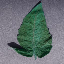

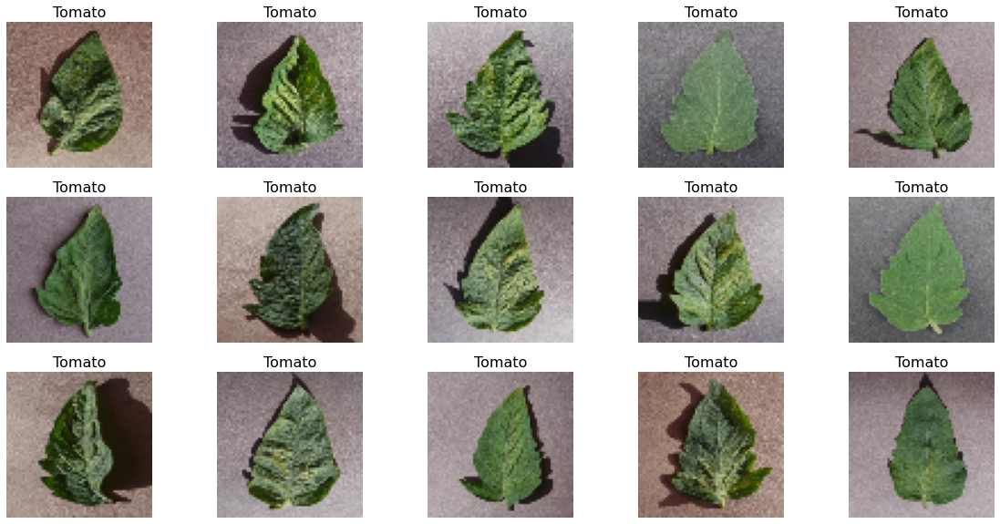

In [ ]:
cv2_imshow(query)
print(" ")
show_images(shape_ranking, shape_result[:image_to_retrieve])

## Texture

Un' altra feature sicuramente significativa per il riconoscimento delle immagini può essere la texture
- le foglie presentano venature e dettagli che possono aiutare a riconoscerle.

Per poter estrarre le feature relative alla texture si è deciso di utilizzare i filtri di **Gabor**

- un filtro di Gabor è una sinusoide ottenuta progressivamente a partire da una gaussiana e regolata da tre parametri principali
  - ampiezza della gaussaina;
  - frequenza;
  - orientazione rispetto allo spazio x,y.
- più la texture dell'immagine assomiglia a quella definita dal filtro, più la risposta ottenuta è buona

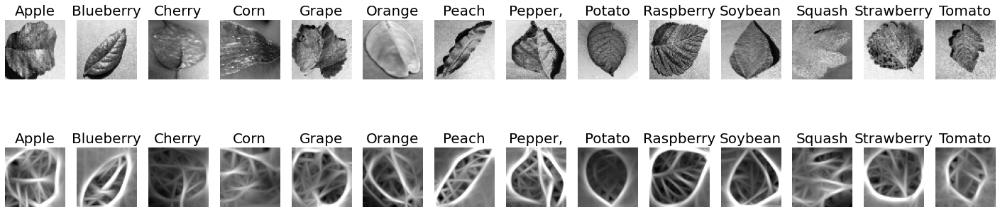

In [ ]:
_, axs = plt.subplots(2, len(class_names),figsize=(25, 25))
plt.subplots_adjust(bottom=0.5, top=0.7, hspace=0)

filters = []
ksize = 31
for theta in np.arange(0, np.pi, np.pi / 16):
  kern = cv2.getGaborKernel((ksize, ksize), 4.0, theta, 10.0, 0.5, 0, ktype=cv2.CV_32F)
  kern /= 1.5 * kern.sum()
  filters.append(kern)

for i in range(len(class_names)):
  train_class_pos=np.where(train_y==i)
  rnd_idx=random.randint(0,len(train_class_pos[0]))
  p=train_class_pos[0][rnd_idx]
  img = train_x[p]
  gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  
  accum = np.zeros_like(gray_img)
  for kern in filters:
    fimg = cv2.filter2D(gray_img, cv2.CV_8UC3, kern)
    np.maximum(accum, fimg, accum)
 
  axs[0,i].imshow(gray_img, cmap='gray'),axs[0, i].axis('off'),axs[0, i].set_title(class_names[train_y[p]], fontsize=20)
  axs[1,i].imshow(accum, cmap='gray'),axs[1, i].axis('off'),axs[1, i].set_title(class_names[train_y[p]], fontsize=20)

In [ ]:
def build_filters():
 filters = []
 ksize = 31
 for theta in np.arange(0, np.pi, np.pi / 16):
  kern = cv2.getGaborKernel((ksize, ksize), 4.0, theta, 10.0, 0.5, 0, ktype=cv2.CV_32F)
  kern /= 1.5 * kern.sum()
  filters.append(kern)
 return filters
 
def process(img, filters):
 accum = np.zeros_like(img)
 for kern in filters:
  fimg = cv2.filter2D(img, cv2.CV_8UC3, kern)
  np.maximum(accum, fimg, accum)
 return accum

def compute_texture_feature_similarities(f1, f2):
  return np.minimum(f1, f2).sum()

def compute_texture_ranking(db_feature, query_feature_vector):
  similarities =[compute_texture_feature_similarities(db_feature_vector, query_feature_vector) for db_feature_vector in db_feature]
  sorted_idx = np.array(similarities).argsort()[::-1]
  return sorted_idx

### Risultati texture

Una volta ottenute le informazioni sulla texture, sia sul training set che sulla query, abbiamo prodotto una prima classifica delle immagini, per vedere quali foglie risultassero più simili a quella da classificare.

In [ ]:
training_img_list = [file for file in glob.glob(os.path.join(db_path_train + "/*/*"))]
train_gray_images = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in train_x]
filters = build_filters()
train_texture_features = [process(img, filters) for img in tqdm(train_gray_images)]
query_texture_features = process(cv2.cvtColor(query, cv2.COLOR_BGR2GRAY), filters)
texture_ranking = compute_texture_ranking(train_texture_features, query_texture_features)
texture_result = [train_x[i] for i in texture_ranking]


  0%|          | 0/70295 [00:00<?, ?it/s]

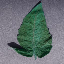

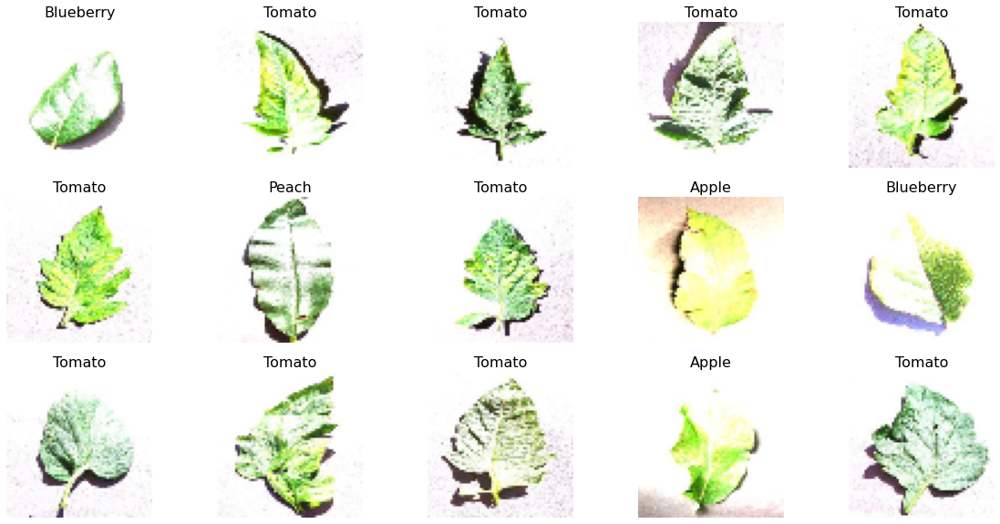

In [ ]:
cv2_imshow(query)
print(" ")
show_images(texture_ranking, texture_result[:image_to_retrieve])

## Feature Colore

Infine un'altra feature che può essere utilizzata per riconoscere le diverse foglie è il colore:
 - è vero che le foglie non differiscono molto fra loro per il colore, ma queste feature possono comunque contribuire nella distinzione delle diverse classi;
  - ad esempio, se si guarda le immagini, le foglie delle arance presentano in genere un verde più scuro rispetto a quello, ad esempio, delle foglie delle fragole;

  - alcune malattie che possono prendere alcune piante, inoltre, ne provocano un ingiallimento della foglia, quindi, anche in questo caso il colore può essere utile per il riconoscimento.

Per il calcolo dell'istogramma colore è stato utilizzato lo spazio colore **HSV** e un numero di **bin** pari a **20**

- i range, dei diversi parametri dello spazio, sono gli stessi che sono stati utilizzati per individuare la forma della foglia.

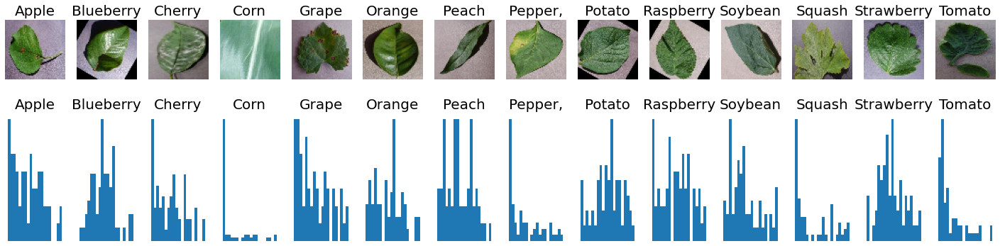

In [ ]:
_, axs = plt.subplots(2, len(class_names),figsize=(25, 25))
plt.subplots_adjust(bottom=0.5, top=0.7, hspace=0)


for i in range(len(class_names)):
  train_class_pos=np.where(train_y==i)
  rnd_idx=random.randint(0,len(train_class_pos[0]))
  p=train_class_pos[0][rnd_idx]
  img = train_x[p]
  hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)

  # threshold using inRange
  h_min_value=49  
  h_max_value=104 
  s_min_value=19 
  s_max_value=255 
  v_min_value=0 
  v_max_value=255 

  lower_bound = np.array([h_min_value, s_min_value, v_min_value])
  upper_bound = np.array([h_max_value, s_max_value, v_max_value])

  mask = cv2.inRange(hsv,lower_bound,upper_bound)
  sm = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((1,1), np.uint8))

  bin_count = 20
  s = img.shape
  pixel_count = s[0]*s[1]
  channels = [0,1,2]
  h_range=[h_min_value, h_max_value]
  hists = [cv2.calcHist([img],[c],sm,[bin_count], h_range)/pixel_count for c in channels]
  RGB_hist = np.concatenate((hists[0], hists[1], hists[2]), axis=0)
 
  axs[0,i].imshow(img, cmap='gray'),axs[0, i].axis('off'),axs[0, i].set_title(class_names[train_y[p]], fontsize=20)
  axs[1,i].hist(RGB_hist, bins=bin_count),axs[1, i].axis('off'),axs[1, i].set_title(class_names[train_y[p]], fontsize=20)

In [ ]:
def compute_color_features(img):
  hsv = cv2.cvtColor(img,cv2.COLOR_BGR2HSV)

  # threshold using inRange
  h_min_value=49  
  h_max_value=104 
  s_min_value=19 
  s_max_value=255 
  v_min_value=0 
  v_max_value=255 

  lower_bound = np.array([h_min_value, s_min_value, v_min_value])
  upper_bound = np.array([h_max_value, s_max_value, v_max_value])

  mask = cv2.inRange(hsv,lower_bound,upper_bound)
  sm = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((1,1), np.uint8))

  bin_count = 20
  s = img.shape
  pixel_count = s[0]*s[1]
  channels = [0,1,2]
  h_range=[h_min_value, h_max_value]
  hists = [cv2.calcHist([img],[c],sm,[bin_count], h_range)/pixel_count for c in channels]
  RGB_hist = np.concatenate((hists[0], hists[1], hists[2]), axis=0)
  return RGB_hist

def compute_color_feature_similarities(f1, f2):
  return np.minimum(f1, f2).sum()

def compute_color_ranking(db_features, query_feature_vector):
  similarities =[compute_color_feature_similarities(db_feature_vector, query_feature_vector) for db_feature_vector in db_features]
  sorted_idx = np.array(similarities).argsort()[::-1]
  return sorted_idx

### Risultati feature colore

Una volta ottenute le informazioni sulle feature colore sia sul training set che sulla query abbiamo prodotto una prima classifica delle immagini, per vedere quali foglie risultassero più simili a quella da classificare sulla base di queste feature.

In [ ]:
train_color_features = [compute_color_features(img) for img in tqdm(train_x)]
query_color_features = compute_color_features(query)
color_ranking = compute_color_ranking(train_color_features, query_color_features)
color_result = [train_x[i] for i in color_ranking]

  0%|          | 0/70295 [00:00<?, ?it/s]

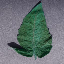

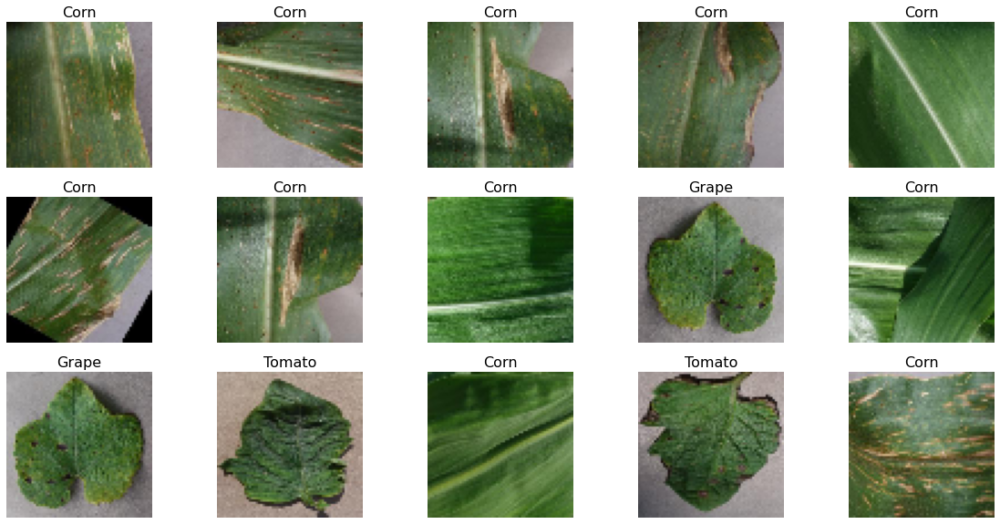

In [ ]:
cv2_imshow(query)
print(" ")
show_images(color_ranking, color_result[:image_to_retrieve])

## Classifica finale

Una volta ottenute tutte le diverse feature e prodotte le diverse classifiche possiamo andare a fondere i risultati
 - per la fusione dei risultati è stata utilizzato l'algoritmo **borda count**, assegnando un peso diverso alle diverse feature in base ai risultati ottenuti;
  - le feature di forma hanno un peso maggiore rispetto alle feature di texture che, invece, hanno peso maggiore rispetto alle feature colore.

- alla fine è stata calcolata la classifica finale, delle immagini più simili.

In [ ]:
def add_scores(scores, ranking, points):
  for i in range(image_to_retrieve):
    scores[ranking[i]] = scores[ranking[i]]+points[i]
  return scores

def borda_count(rankings, weights):
  points = np.arange(image_to_retrieve+1)[::-1][:image_to_retrieve]
  tot_img_scores = np.zeros(len(train_x))
  
  for i in range(len(rankings)):
    tot_img_scores = add_scores(tot_img_scores, rankings[i], weights[i]*points)
  return tot_img_scores

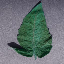

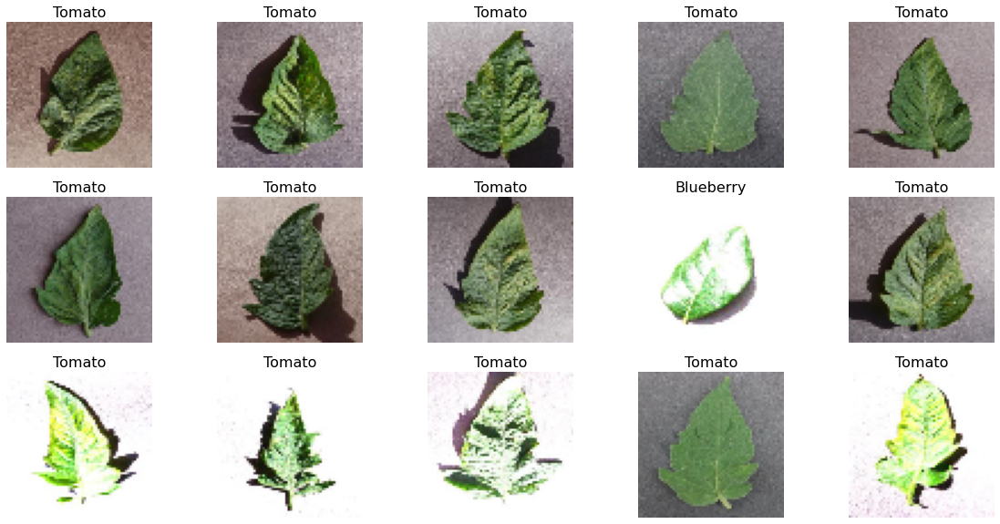

In [ ]:
tot_scores = borda_count([color_ranking, shape_ranking, texture_ranking], [0.1, 0.6, 0.3])
tot_ranking = np.array(tot_scores).argsort()[::-1]

result = [train_x[i] for i in tot_ranking]
cv2_imshow(query)
print(" ")
show_images(tot_ranking, result[:image_to_retrieve])

# Strategia di classificazione

Una volta visionati i risultati, si è passati alla definizione della strategia di classificazione:
- sono stati sommati i punteggi ottenuti dalle diverse immagini per le diverse feature;
- i punteggi sono stati ragruppati per classi e all'immagine è stata assegnata la classe con il punteggio più elevato.

In [ ]:
def compute_class(tot_scores, tot_ranking):
  result = np.zeros(len(class_names))
  
  for i in range(len(tot_ranking)):
    result[train_y[tot_ranking[i]]] += tot_scores[tot_ranking[i]]
  
  return result

In [ ]:
result = compute_class(tot_scores, tot_ranking[:image_to_retrieve])
predict = np.array(result).argsort()[::-1][0]

print("Predict: " + class_names[predict] + " True: " + class_names[valid_y[true_index]])

Predict: Tomato True: Tomato


# Test sul validation set

A questo punto, si è passati alla misura delle prestazioni sul validation set
- si è considerato un insieme di immagini più ristretto rispetto al totale, a causa del tempo necessario per la classificazione e la RAM a disposizione
- le diverse immagini sono state classificate una ad una
 - estraendo le feature per ognuna di loro e confrontandole con quelle del training set;
 - determinando la classe di appartenenza in base alla strategia di classificazione definita precedentemente.

In [ ]:
from sklearn.model_selection import train_test_split

# using the train test split function
modified_valid_x, test_x, modified_valid_y, test_y = train_test_split(valid_x, valid_y,
                                   random_state=104, 
                                   test_size=0.30, 
                                   shuffle=True)

print(modified_valid_x.shape)
print(test_x.shape)

(12300, 64, 64, 3)
(5272, 64, 64, 3)


In [ ]:
n_for_class = 100
indices = np.array([], dtype=int)
true = np.array([], dtype=int)
for i in range(len(class_names)):
  idxs = np.array(np.where(modified_valid_y==i)[0])
  indices = np.concatenate((indices, idxs[:n_for_class]))
  true = np.concatenate((true, np.full((n_for_class, ), i)))

reduced_valid_x = [modified_valid_x[i] for i in indices]
reduced_valid_y = [modified_valid_y[i] for i in indices]

valid_shape_features = [compute_shape_features(img) for img in tqdm(reduced_valid_x)]
valid_gray_images = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in reduced_valid_x]
valid_texture_features = [process(img, filters) for img in tqdm(valid_gray_images)]

valid_color_features = [compute_color_features(img) for img in tqdm(reduced_valid_x)]

  0%|          | 0/1400 [00:00<?, ?it/s]

  0%|          | 0/1400 [00:00<?, ?it/s]

  0%|          | 0/1400 [00:00<?, ?it/s]

  0%|          | 0/1400 [00:00<?, ?it/s]

True: Apple


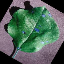

Predict: Strawberry


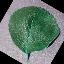

-----------------------------------
True: Apple


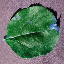

Predict: Strawberry


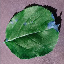

-----------------------------------
True: Apple


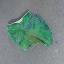

Predict: Tomato


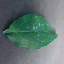

-----------------------------------
True: Apple


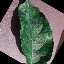

Predict: Raspberry


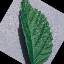

-----------------------------------
True: Apple


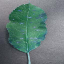

Predict: Tomato


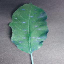

-----------------------------------
True: Apple


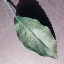

Predict: Blueberry


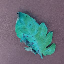

-----------------------------------
True: Apple


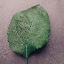

Predict: Blueberry


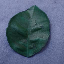

-----------------------------------
True: Apple


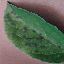

Predict: Orange


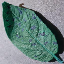

-----------------------------------
True: Apple


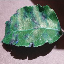

Predict: Strawberry


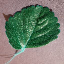

-----------------------------------
True: Apple


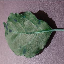

Predict: Tomato


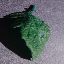

-----------------------------------
True: Apple


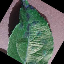

Predict: Tomato


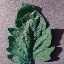

-----------------------------------
True: Apple


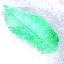

Predict: Cherry


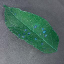

-----------------------------------
True: Apple


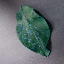

Predict: Blueberry


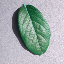

-----------------------------------
True: Apple


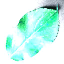

Predict: Cherry


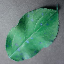

-----------------------------------
True: Apple


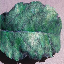

Predict: Potato


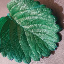

-----------------------------------
True: Apple


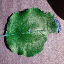

Predict: Strawberry


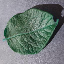

-----------------------------------
True: Apple


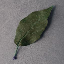

Predict: Peach


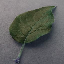

-----------------------------------
True: Apple


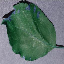

Predict: Strawberry


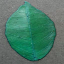

-----------------------------------
True: Apple


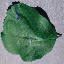

Predict: Potato


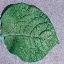

-----------------------------------
True: Apple


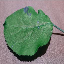

Predict: Strawberry


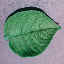

-----------------------------------
True: Apple


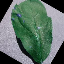

Predict: Potato


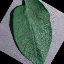

-----------------------------------
True: Apple


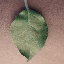

Predict: Tomato


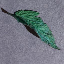

-----------------------------------
True: Apple


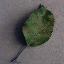

Predict: Tomato


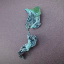

-----------------------------------
True: Apple


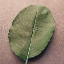

Predict: Soybean


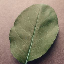

-----------------------------------
True: Apple


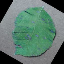

Predict: Orange


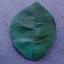

-----------------------------------
True: Apple


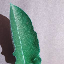

Predict: Peach


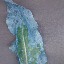

-----------------------------------
True: Apple


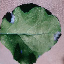

Predict: Orange


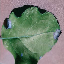

-----------------------------------
True: Apple


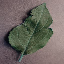

Predict: Tomato


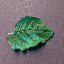

-----------------------------------
True: Apple


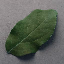

Predict: Potato


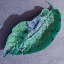

-----------------------------------
True: Apple


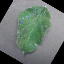

Predict: Blueberry


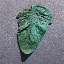

-----------------------------------
True: Apple


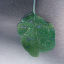

Predict: Tomato


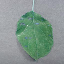

-----------------------------------
True: Apple


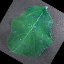

Predict: Strawberry


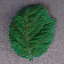

-----------------------------------
True: Apple


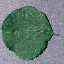

Predict: Raspberry


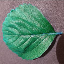

-----------------------------------
True: Apple


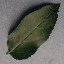

Predict: Peach


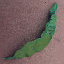

-----------------------------------
True: Apple


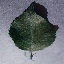

Predict: Tomato


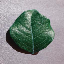

-----------------------------------
True: Apple


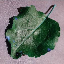

Predict: Strawberry


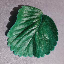

-----------------------------------
True: Apple


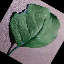

Predict: Orange


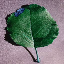

-----------------------------------
True: Apple


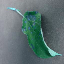

Predict: Corn


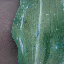

-----------------------------------
True: Apple


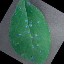

Predict: Raspberry


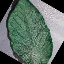

-----------------------------------
True: Apple


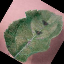

Predict: Cherry


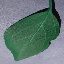

-----------------------------------
True: Apple


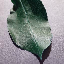

Predict: Potato


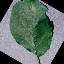

-----------------------------------
True: Apple


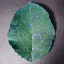

Predict: Orange


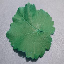

-----------------------------------
True: Apple


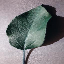

Predict: Tomato


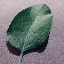

-----------------------------------
True: Apple


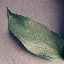

Predict: Peach


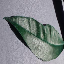

-----------------------------------
True: Apple


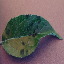

Predict: Tomato


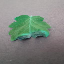

-----------------------------------
True: Apple


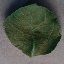

Predict: Tomato


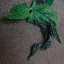

-----------------------------------
True: Apple


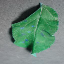

Predict: Tomato


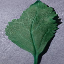

-----------------------------------
True: Apple


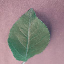

Predict: Tomato


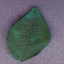

-----------------------------------
True: Apple


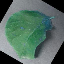

Predict: Strawberry


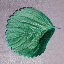

-----------------------------------
True: Apple


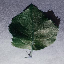

Predict: Orange


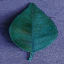

-----------------------------------
True: Apple


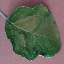

Predict: Strawberry


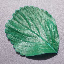

-----------------------------------
True: Apple


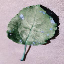

Predict: Tomato


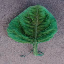

-----------------------------------
True: Apple


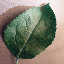

Predict: Cherry


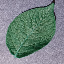

-----------------------------------
True: Apple


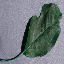

Predict: Cherry


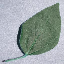

-----------------------------------
True: Apple


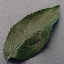

Predict: Peach


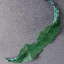

-----------------------------------
True: Apple


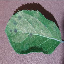

Predict: Potato


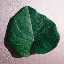

-----------------------------------
True: Apple


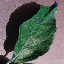

Predict: Tomato


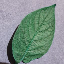

-----------------------------------
True: Apple


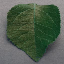

Predict: Grape


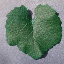

-----------------------------------
True: Apple


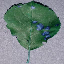

Predict: Pepper,


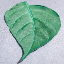

-----------------------------------
True: Apple


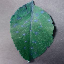

Predict: Potato


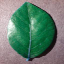

-----------------------------------
True: Apple


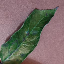

Predict: Peach


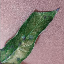

-----------------------------------
True: Apple


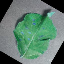

Predict: Blueberry


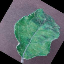

-----------------------------------
True: Apple


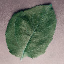

Predict: Strawberry


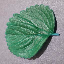

-----------------------------------
True: Apple


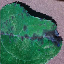

Predict: Squash


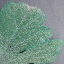

-----------------------------------
True: Apple


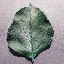

Predict: Tomato


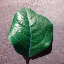

-----------------------------------
True: Apple


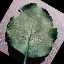

Predict: Orange


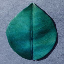

-----------------------------------
True: Apple


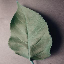

Predict: Tomato


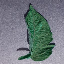

-----------------------------------
True: Apple


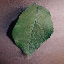

Predict: Tomato


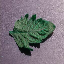

-----------------------------------
True: Apple


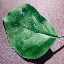

Predict: Strawberry


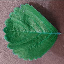

-----------------------------------
True: Apple


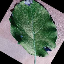

Predict: Potato


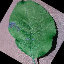

-----------------------------------
True: Apple


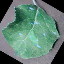

Predict: Orange


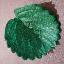

-----------------------------------
True: Blueberry


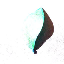

Predict: Tomato


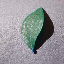

-----------------------------------
True: Blueberry


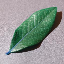

Predict: Cherry


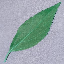

-----------------------------------
True: Blueberry


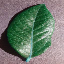

Predict: Strawberry


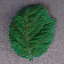

-----------------------------------
True: Blueberry


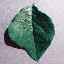

Predict: Orange


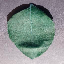

-----------------------------------
True: Blueberry


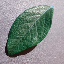

Predict: Tomato


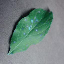

-----------------------------------
True: Blueberry


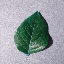

Predict: Tomato


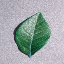

-----------------------------------
True: Blueberry


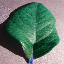

Predict: Orange


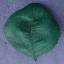

-----------------------------------
True: Blueberry


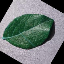

Predict: Tomato


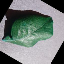

-----------------------------------
True: Blueberry


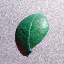

Predict: Tomato


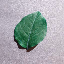

-----------------------------------
True: Blueberry


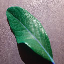

Predict: Cherry


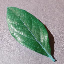

-----------------------------------
True: Blueberry


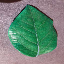

Predict: Tomato


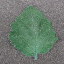

-----------------------------------
True: Blueberry


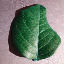

Predict: Tomato


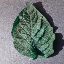

-----------------------------------
True: Blueberry


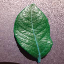

Predict: Orange


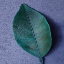

-----------------------------------
True: Blueberry


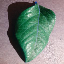

Predict: Tomato


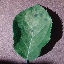

-----------------------------------
True: Blueberry


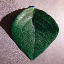

Predict: Pepper,


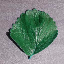

-----------------------------------
True: Blueberry


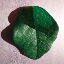

Predict: Tomato


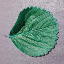

-----------------------------------
True: Blueberry


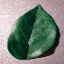

Predict: Strawberry


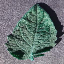

-----------------------------------
True: Blueberry


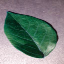

Predict: Soybean


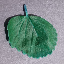

-----------------------------------
True: Blueberry


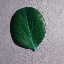

Predict: Tomato


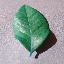

-----------------------------------
True: Blueberry


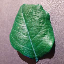

Predict: Tomato


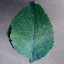

-----------------------------------
True: Blueberry


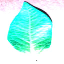

Predict: Tomato


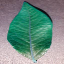

-----------------------------------
True: Blueberry


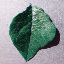

Predict: Orange


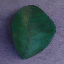

-----------------------------------
True: Blueberry


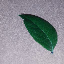

Predict: Tomato


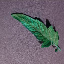

-----------------------------------
True: Blueberry


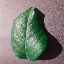

Predict: Tomato


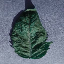

-----------------------------------
True: Blueberry


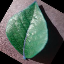

Predict: Tomato


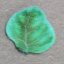

-----------------------------------
True: Blueberry


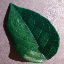

Predict: Raspberry


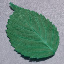

-----------------------------------
True: Blueberry


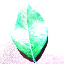

Predict: Orange


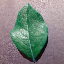

-----------------------------------
True: Blueberry


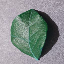

Predict: Tomato


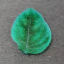

-----------------------------------
True: Blueberry


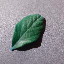

Predict: Tomato


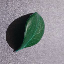

-----------------------------------
True: Blueberry


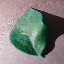

Predict: Tomato


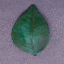

-----------------------------------
True: Blueberry


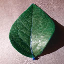

Predict: Orange


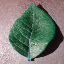

-----------------------------------
True: Blueberry


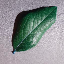

Predict: Cherry


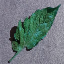

-----------------------------------
True: Blueberry


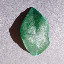

Predict: Tomato


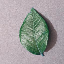

-----------------------------------
True: Blueberry


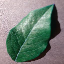

Predict: Soybean


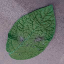

-----------------------------------
True: Blueberry


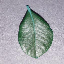

Predict: Tomato


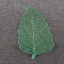

-----------------------------------
True: Blueberry


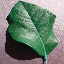

Predict: Cherry


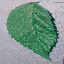

-----------------------------------
True: Blueberry


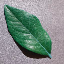

Predict: Cherry


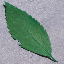

-----------------------------------
True: Blueberry


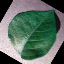

Predict: Strawberry


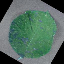

-----------------------------------
True: Blueberry


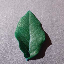

Predict: Tomato


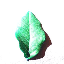

-----------------------------------
True: Blueberry


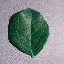

Predict: Tomato


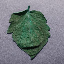

-----------------------------------
True: Blueberry


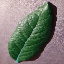

Predict: Peach


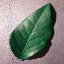

-----------------------------------
True: Blueberry


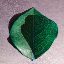

Predict: Tomato


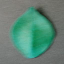

-----------------------------------
True: Blueberry


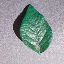

Predict: Tomato


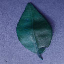

-----------------------------------
True: Blueberry


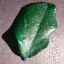

Predict: Tomato


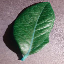

-----------------------------------
True: Blueberry


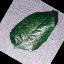

Predict: Tomato


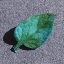

-----------------------------------
True: Blueberry


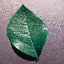

Predict: Tomato


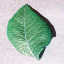

-----------------------------------
True: Blueberry


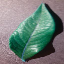

Predict: Cherry


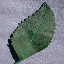

-----------------------------------
True: Blueberry


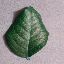

Predict: Tomato


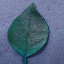

-----------------------------------
True: Blueberry


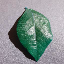

Predict: Orange


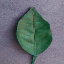

-----------------------------------
True: Blueberry


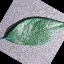

Predict: Tomato


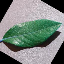

-----------------------------------
True: Blueberry


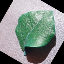

Predict: Apple


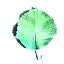

-----------------------------------
True: Blueberry


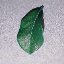

Predict: Tomato


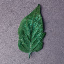

-----------------------------------
True: Blueberry


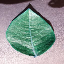

Predict: Orange


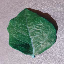

-----------------------------------
True: Blueberry


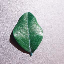

Predict: Tomato


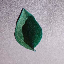

-----------------------------------
True: Blueberry


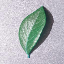

Predict: Tomato


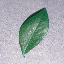

-----------------------------------
True: Blueberry


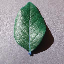

Predict: Tomato


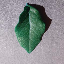

-----------------------------------
True: Blueberry


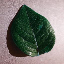

Predict: Tomato


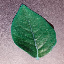

-----------------------------------
True: Blueberry


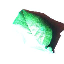

Predict: Tomato


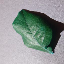

-----------------------------------
True: Blueberry


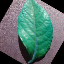

Predict: Tomato


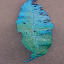

-----------------------------------
True: Blueberry


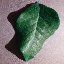

Predict: Tomato


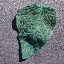

-----------------------------------
True: Blueberry


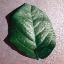

Predict: Strawberry


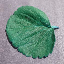

-----------------------------------
True: Blueberry


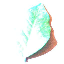

Predict: Tomato


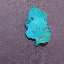

-----------------------------------
True: Blueberry


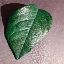

Predict: Tomato


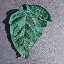

-----------------------------------
True: Blueberry


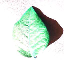

Predict: Tomato


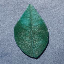

-----------------------------------
True: Blueberry


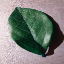

Predict: Potato


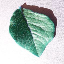

-----------------------------------
True: Cherry


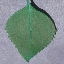

Predict: Orange


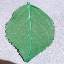

-----------------------------------
True: Cherry


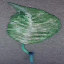

Predict: Raspberry


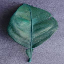

-----------------------------------
True: Cherry


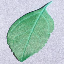

Predict: Apple


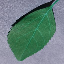

-----------------------------------
True: Cherry


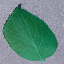

Predict: Potato


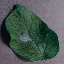

-----------------------------------
True: Cherry


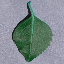

Predict: Blueberry


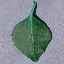

-----------------------------------
True: Cherry


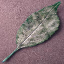

Predict: Apple


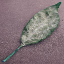

-----------------------------------
True: Cherry


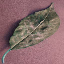

Predict: Peach


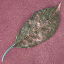

-----------------------------------
True: Cherry


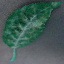

Predict: Apple


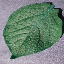

-----------------------------------
True: Cherry


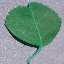

Predict: Pepper,


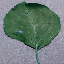

-----------------------------------
True: Cherry


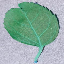

Predict: Apple


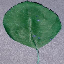

-----------------------------------
True: Cherry


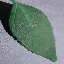

Predict: Pepper,


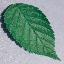

-----------------------------------
True: Cherry


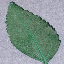

Predict: Raspberry


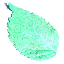

-----------------------------------
True: Cherry


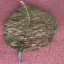

Predict: Potato


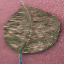

-----------------------------------
True: Cherry


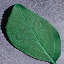

Predict: Potato


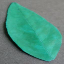

-----------------------------------
True: Cherry


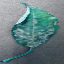

Predict: Squash


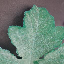

-----------------------------------
True: Cherry


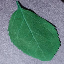

Predict: Potato


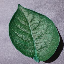

-----------------------------------
True: Cherry


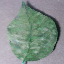

Predict: Orange


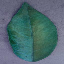

-----------------------------------
True: Cherry


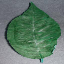

Predict: Orange


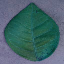

-----------------------------------
True: Cherry


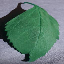

Predict: Pepper,


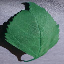

-----------------------------------
True: Cherry


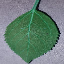

Predict: Orange


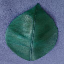

-----------------------------------
True: Cherry


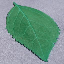

Predict: Potato


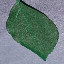

-----------------------------------
True: Cherry


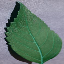

Predict: Soybean


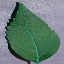

-----------------------------------
True: Cherry


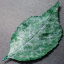

Predict: Soybean


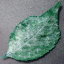

-----------------------------------
True: Cherry


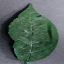

Predict: Orange


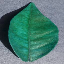

-----------------------------------
True: Cherry


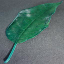

Predict: Corn


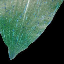

-----------------------------------
True: Cherry


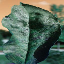

Predict: Squash


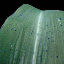

-----------------------------------
True: Cherry


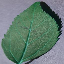

Predict: Strawberry


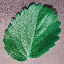

-----------------------------------
True: Cherry


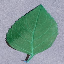

Predict: Potato


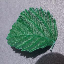

-----------------------------------
True: Cherry


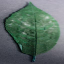

Predict: Potato


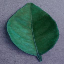

-----------------------------------
True: Cherry


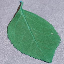

Predict: Potato


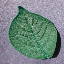

-----------------------------------
True: Cherry


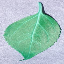

Predict: Pepper,


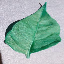

-----------------------------------
True: Cherry


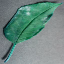

Predict: Corn


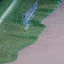

-----------------------------------
True: Cherry


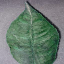

Predict: Pepper,


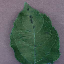

-----------------------------------
True: Cherry


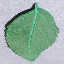

Predict: Orange


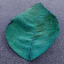

-----------------------------------
True: Cherry


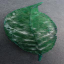

Predict: Potato


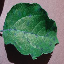

-----------------------------------
True: Cherry


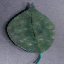

Predict: Orange


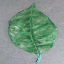

-----------------------------------
True: Cherry


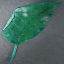

Predict: Corn


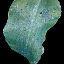

-----------------------------------
True: Cherry


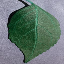

Predict: Orange


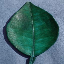

-----------------------------------
True: Corn


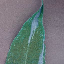

Predict: Peach


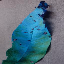

-----------------------------------
True: Corn


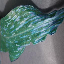

Predict: Pepper,


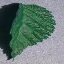

-----------------------------------
True: Corn


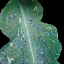

Predict: Squash


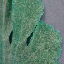

-----------------------------------
True: Corn


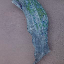

Predict: Tomato


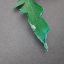

-----------------------------------
True: Corn


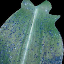

Predict: Squash


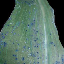

-----------------------------------
True: Corn


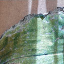

Predict: Squash


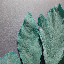

-----------------------------------
True: Corn


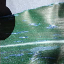

Predict: Squash


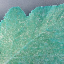

-----------------------------------
True: Corn


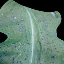

Predict: Squash


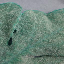

-----------------------------------
True: Corn


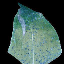

Predict: Tomato


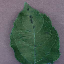

-----------------------------------
True: Grape


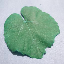

Predict: Strawberry


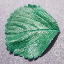

-----------------------------------
True: Grape


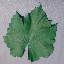

Predict: Raspberry


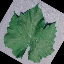

-----------------------------------
True: Grape


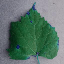

Predict: Raspberry


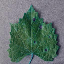

-----------------------------------
True: Grape


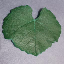

Predict: Potato


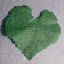

-----------------------------------
True: Grape


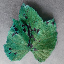

Predict: Tomato


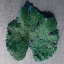

-----------------------------------
True: Grape


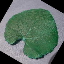

Predict: Strawberry


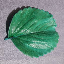

-----------------------------------
True: Grape


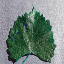

Predict: Tomato


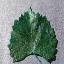

-----------------------------------
True: Grape


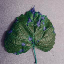

Predict: Tomato


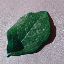

-----------------------------------
True: Grape


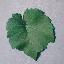

Predict: Strawberry


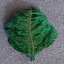

-----------------------------------
True: Grape


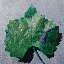

Predict: Pepper,


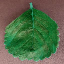

-----------------------------------
True: Grape


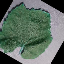

Predict: Apple


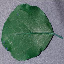

-----------------------------------
True: Grape


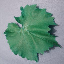

Predict: Orange


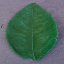

-----------------------------------
True: Grape


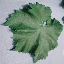

Predict: Raspberry


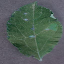

-----------------------------------
True: Grape


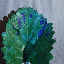

Predict: Pepper,


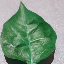

-----------------------------------
True: Grape


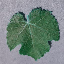

Predict: Strawberry


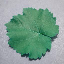

-----------------------------------
True: Grape


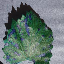

Predict: Tomato


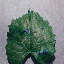

-----------------------------------
True: Grape


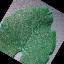

Predict: Apple


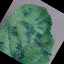

-----------------------------------
True: Grape


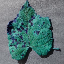

Predict: Tomato


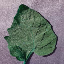

-----------------------------------
True: Grape


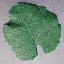

Predict: Strawberry


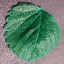

-----------------------------------
True: Grape


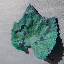

Predict: Pepper,


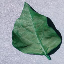

-----------------------------------
True: Grape


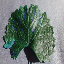

Predict: Tomato


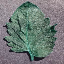

-----------------------------------
True: Grape


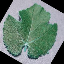

Predict: Tomato


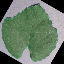

-----------------------------------
True: Grape


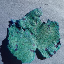

Predict: Pepper,


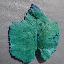

-----------------------------------
True: Grape


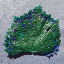

Predict: Pepper,


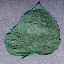

-----------------------------------
True: Grape


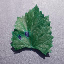

Predict: Tomato


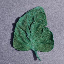

-----------------------------------
True: Grape


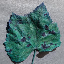

Predict: Pepper,


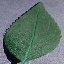

-----------------------------------
True: Grape


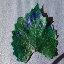

Predict: Tomato


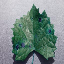

-----------------------------------
True: Grape


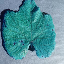

Predict: Squash


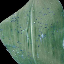

-----------------------------------
True: Grape


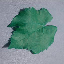

Predict: Strawberry


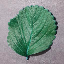

-----------------------------------
True: Grape


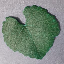

Predict: Cherry


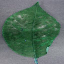

-----------------------------------
True: Grape


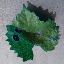

Predict: Orange


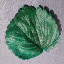

-----------------------------------
True: Grape


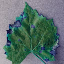

Predict: Pepper,


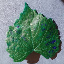

-----------------------------------
True: Grape


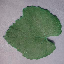

Predict: Raspberry


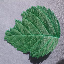

-----------------------------------
True: Grape


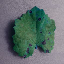

Predict: Tomato


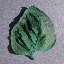

-----------------------------------
True: Grape


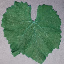

Predict: Strawberry


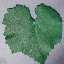

-----------------------------------
True: Grape


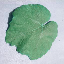

Predict: Strawberry


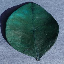

-----------------------------------
True: Grape


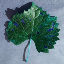

Predict: Tomato


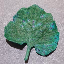

-----------------------------------
True: Grape


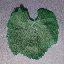

Predict: Strawberry


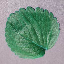

-----------------------------------
True: Orange


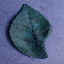

Predict: Tomato


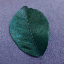

-----------------------------------
True: Orange


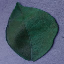

Predict: Strawberry


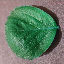

-----------------------------------
True: Orange


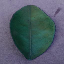

Predict: Blueberry


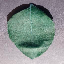

-----------------------------------
True: Orange


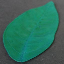

Predict: Cherry


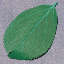

-----------------------------------
True: Orange


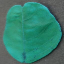

Predict: Strawberry


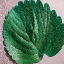

-----------------------------------
True: Orange


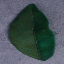

Predict: Tomato


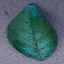

-----------------------------------
True: Orange


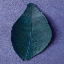

Predict: Tomato


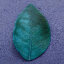

-----------------------------------
True: Orange


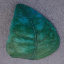

Predict: Raspberry


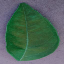

-----------------------------------
True: Orange


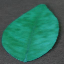

Predict: Cherry


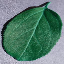

-----------------------------------
True: Orange


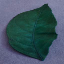

Predict: Strawberry


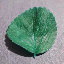

-----------------------------------
True: Orange


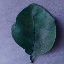

Predict: Tomato


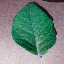

-----------------------------------
True: Orange


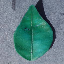

Predict: Tomato


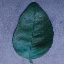

-----------------------------------
True: Orange


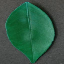

Predict: Cherry


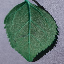

-----------------------------------
True: Orange


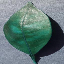

Predict: Cherry


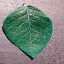

-----------------------------------
True: Orange


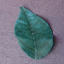

Predict: Blueberry


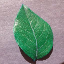

-----------------------------------
True: Orange


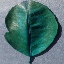

Predict: Cherry


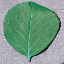

-----------------------------------
True: Orange


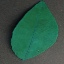

Predict: Strawberry


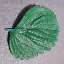

-----------------------------------
True: Orange


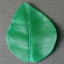

Predict: Soybean


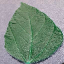

-----------------------------------
True: Orange


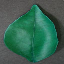

Predict: Pepper,


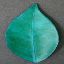

-----------------------------------
True: Orange


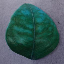

Predict: Strawberry


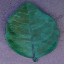

-----------------------------------
True: Orange


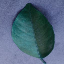

Predict: Tomato


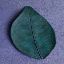

-----------------------------------
True: Orange


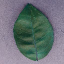

Predict: Blueberry


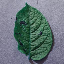

-----------------------------------
True: Orange


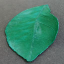

Predict: Strawberry


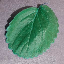

-----------------------------------
True: Orange


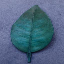

Predict: Blueberry


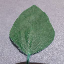

-----------------------------------
True: Orange


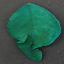

Predict: Cherry


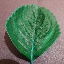

-----------------------------------
True: Orange


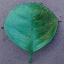

Predict: Raspberry


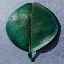

-----------------------------------
True: Orange


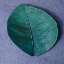

Predict: Strawberry


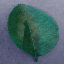

-----------------------------------
True: Orange


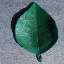

Predict: Blueberry


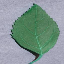

-----------------------------------
True: Orange


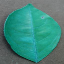

Predict: Strawberry


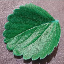

-----------------------------------
True: Orange


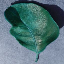

Predict: Pepper,


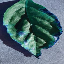

-----------------------------------
True: Orange


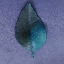

Predict: Tomato


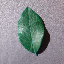

-----------------------------------
True: Orange


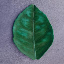

Predict: Blueberry


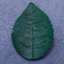

-----------------------------------
True: Peach


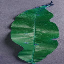

Predict: Orange


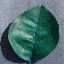

-----------------------------------
True: Peach


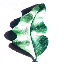

Predict: Tomato


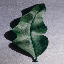

-----------------------------------
True: Peach


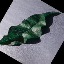

Predict: Tomato


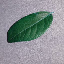

-----------------------------------
True: Peach


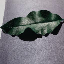

Predict: Tomato


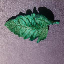

-----------------------------------
True: Peach


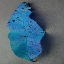

Predict: Apple


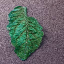

-----------------------------------
True: Peach


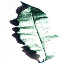

Predict: Tomato


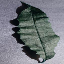

-----------------------------------
True: Peach


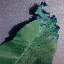

Predict: Apple


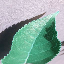

-----------------------------------
True: Peach


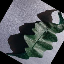

Predict: Tomato


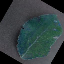

-----------------------------------
True: Peach


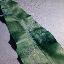

Predict: Tomato


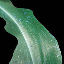

-----------------------------------
True: Peach


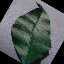

Predict: Tomato


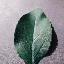

-----------------------------------
True: Peach


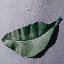

Predict: Tomato


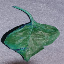

-----------------------------------
True: Peach


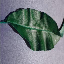

Predict: Apple


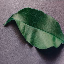

-----------------------------------
True: Peach


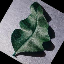

Predict: Tomato


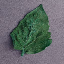

-----------------------------------
True: Peach


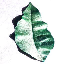

Predict: Tomato


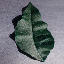

-----------------------------------
True: Peach


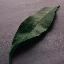

Predict: Blueberry


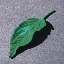

-----------------------------------
True: Peach


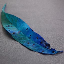

Predict: Tomato


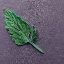

-----------------------------------
True: Peach


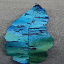

Predict: Pepper,


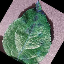

-----------------------------------
True: Peach


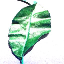

Predict: Tomato


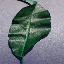

-----------------------------------
True: Peach


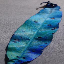

Predict: Cherry


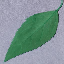

-----------------------------------
True: Peach


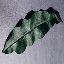

Predict: Tomato


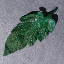

-----------------------------------
True: Peach


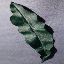

Predict: Blueberry


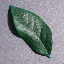

-----------------------------------
True: Peach


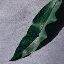

Predict: Tomato


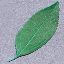

-----------------------------------
True: Peach


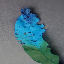

Predict: Apple


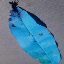

-----------------------------------
True: Peach


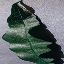

Predict: Raspberry


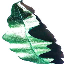

-----------------------------------
True: Peach


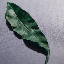

Predict: Tomato


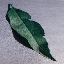

-----------------------------------
True: Peach


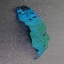

Predict: Tomato


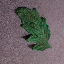

-----------------------------------
True: Peach


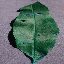

Predict: Orange


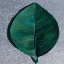

-----------------------------------
True: Peach


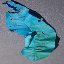

Predict: Pepper,


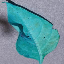

-----------------------------------
True: Peach


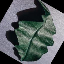

Predict: Blueberry


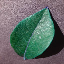

-----------------------------------
True: Peach


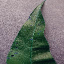

Predict: Corn


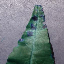

-----------------------------------
True: Peach


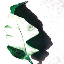

Predict: Tomato


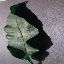

-----------------------------------
True: Peach


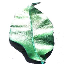

Predict: Tomato


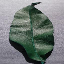

-----------------------------------
True: Peach


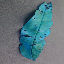

Predict: Blueberry


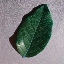

-----------------------------------
True: Peach


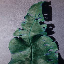

Predict: Squash


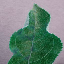

-----------------------------------
True: Peach


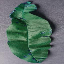

Predict: Raspberry


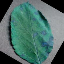

-----------------------------------
True: Peach


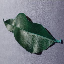

Predict: Blueberry


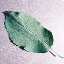

-----------------------------------
True: Pepper,


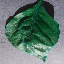

Predict: Cherry


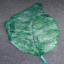

-----------------------------------
True: Pepper,


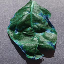

Predict: Orange


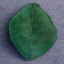

-----------------------------------
True: Pepper,


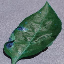

Predict: Cherry


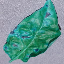

-----------------------------------
True: Pepper,


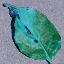

Predict: Raspberry


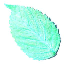

-----------------------------------
True: Pepper,


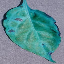

Predict: Potato


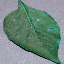

-----------------------------------
True: Pepper,


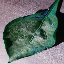

Predict: Cherry


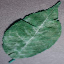

-----------------------------------
True: Pepper,


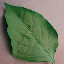

Predict: Potato


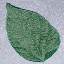

-----------------------------------
True: Pepper,


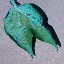

Predict: Apple


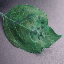

-----------------------------------
True: Pepper,


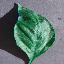

Predict: Orange


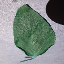

-----------------------------------
True: Pepper,


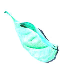

Predict: Peach


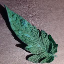

-----------------------------------
True: Pepper,


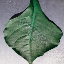

Predict: Cherry


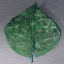

-----------------------------------
True: Pepper,


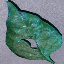

Predict: Raspberry


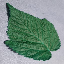

-----------------------------------
True: Pepper,


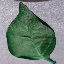

Predict: Raspberry


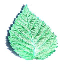

-----------------------------------
True: Pepper,


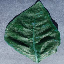

Predict: Orange


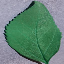

-----------------------------------
True: Pepper,


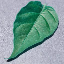

Predict: Raspberry


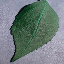

-----------------------------------
True: Pepper,


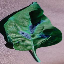

Predict: Tomato


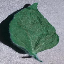

-----------------------------------
True: Pepper,


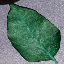

Predict: Raspberry


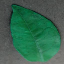

-----------------------------------
True: Pepper,


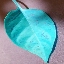

Predict: Potato


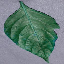

-----------------------------------
True: Pepper,


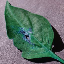

Predict: Potato


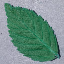

-----------------------------------
True: Pepper,


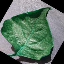

Predict: Raspberry


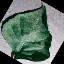

-----------------------------------
True: Pepper,


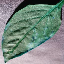

Predict: Potato


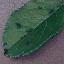

-----------------------------------
True: Pepper,


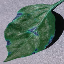

Predict: Raspberry


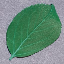

-----------------------------------
True: Pepper,


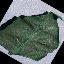

Predict: Raspberry


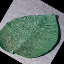

-----------------------------------
True: Pepper,


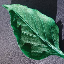

Predict: Raspberry


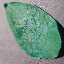

-----------------------------------
True: Pepper,


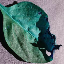

Predict: Tomato


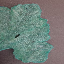

-----------------------------------
True: Pepper,


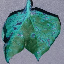

Predict: Grape


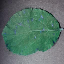

-----------------------------------
True: Pepper,


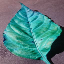

Predict: Soybean


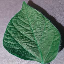

-----------------------------------
True: Pepper,


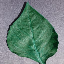

Predict: Tomato


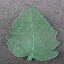

-----------------------------------
True: Pepper,


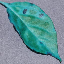

Predict: Cherry


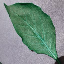

-----------------------------------
True: Pepper,


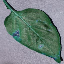

Predict: Cherry


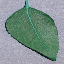

-----------------------------------
True: Pepper,


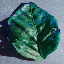

Predict: Potato


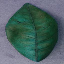

-----------------------------------
True: Pepper,


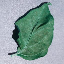

Predict: Tomato


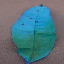

-----------------------------------
True: Pepper,


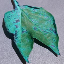

Predict: Potato


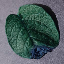

-----------------------------------
True: Pepper,


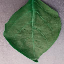

Predict: Potato


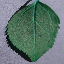

-----------------------------------
True: Pepper,


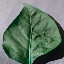

Predict: Soybean


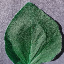

-----------------------------------
True: Pepper,


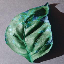

Predict: Orange


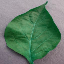

-----------------------------------
True: Pepper,


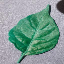

Predict: Tomato


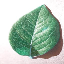

-----------------------------------
True: Pepper,


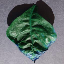

Predict: Orange


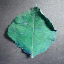

-----------------------------------
True: Pepper,


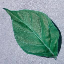

Predict: Raspberry


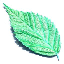

-----------------------------------
True: Pepper,


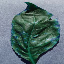

Predict: Orange


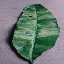

-----------------------------------
True: Pepper,


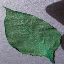

Predict: Soybean


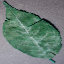

-----------------------------------
True: Pepper,


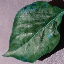

Predict: Squash


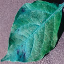

-----------------------------------
True: Pepper,


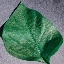

Predict: Soybean


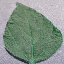

-----------------------------------
True: Pepper,


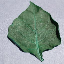

Predict: Tomato


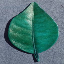

-----------------------------------
True: Pepper,


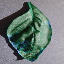

Predict: Orange


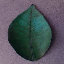

-----------------------------------
True: Potato


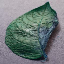

Predict: Strawberry


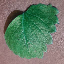

-----------------------------------
True: Potato


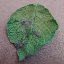

Predict: Pepper,


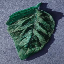

-----------------------------------
True: Potato


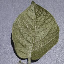

Predict: Apple


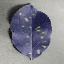

-----------------------------------
True: Potato


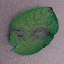

Predict: Strawberry


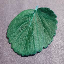

-----------------------------------
True: Potato


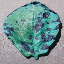

Predict: Pepper,


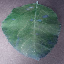

-----------------------------------
True: Potato


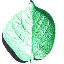

Predict: Orange


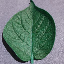

-----------------------------------
True: Potato


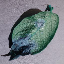

Predict: Apple


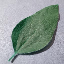

-----------------------------------
True: Potato


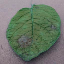

Predict: Strawberry


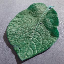

-----------------------------------
True: Potato


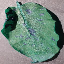

Predict: Strawberry


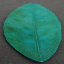

-----------------------------------
True: Potato


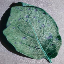

Predict: Cherry


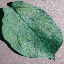

-----------------------------------
True: Potato


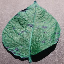

Predict: Orange


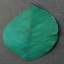

-----------------------------------
True: Potato


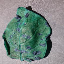

Predict: Pepper,


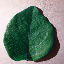

-----------------------------------
True: Potato


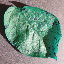

Predict: Strawberry


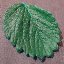

-----------------------------------
True: Potato


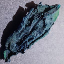

Predict: Tomato


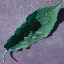

-----------------------------------
True: Potato


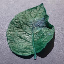

Predict: Strawberry


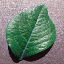

-----------------------------------
True: Potato


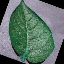

Predict: Raspberry


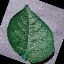

-----------------------------------
True: Potato


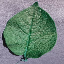

Predict: Orange


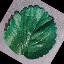

-----------------------------------
True: Potato


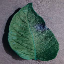

Predict: Tomato


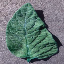

-----------------------------------
True: Potato


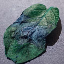

Predict: Pepper,


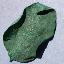

-----------------------------------
True: Potato


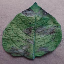

Predict: Pepper,


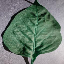

-----------------------------------
True: Potato


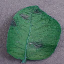

Predict: Orange


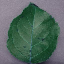

-----------------------------------
True: Potato


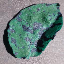

Predict: Strawberry


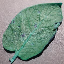

-----------------------------------
True: Potato


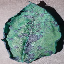

Predict: Strawberry


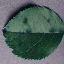

-----------------------------------
True: Potato


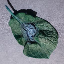

Predict: Soybean


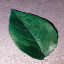

-----------------------------------
True: Potato


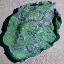

Predict: Strawberry


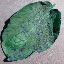

-----------------------------------
True: Potato


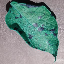

Predict: Raspberry


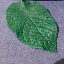

-----------------------------------
True: Potato


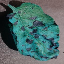

Predict: Strawberry


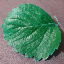

-----------------------------------
True: Potato


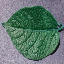

Predict: Strawberry


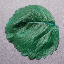

-----------------------------------
True: Potato


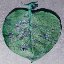

Predict: Strawberry


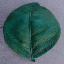

-----------------------------------
True: Potato


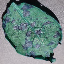

Predict: Cherry


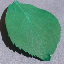

-----------------------------------
True: Potato


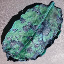

Predict: Strawberry


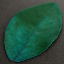

-----------------------------------
True: Potato


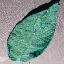

Predict: Pepper,


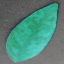

-----------------------------------
True: Potato


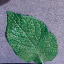

Predict: Raspberry


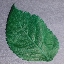

-----------------------------------
True: Potato


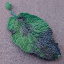

Predict: Blueberry


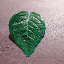

-----------------------------------
True: Potato


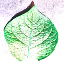

Predict: Tomato


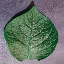

-----------------------------------
True: Potato


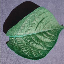

Predict: Orange


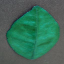

-----------------------------------
True: Potato


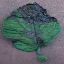

Predict: Cherry


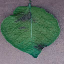

-----------------------------------
True: Potato


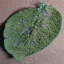

Predict: Pepper,


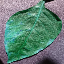

-----------------------------------
True: Potato


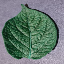

Predict: Cherry


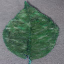

-----------------------------------
True: Potato


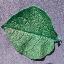

Predict: Strawberry


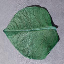

-----------------------------------
True: Potato


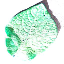

Predict: Strawberry


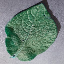

-----------------------------------
True: Potato


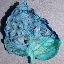

Predict: Tomato


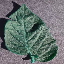

-----------------------------------
True: Potato


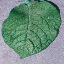

Predict: Pepper,


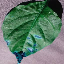

-----------------------------------
True: Potato


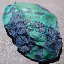

Predict: Pepper,


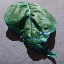

-----------------------------------
True: Potato


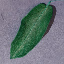

Predict: Peach


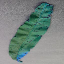

-----------------------------------
True: Potato


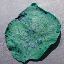

Predict: Orange


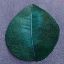

-----------------------------------
True: Potato


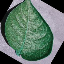

Predict: Raspberry


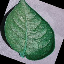

-----------------------------------
True: Potato


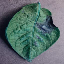

Predict: Orange


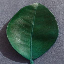

-----------------------------------
True: Potato


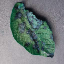

Predict: Cherry


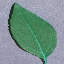

-----------------------------------
True: Potato


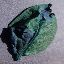

Predict: Apple


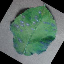

-----------------------------------
True: Potato


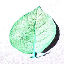

Predict: Blueberry


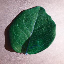

-----------------------------------
True: Potato


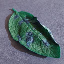

Predict: Cherry


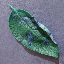

-----------------------------------
True: Potato


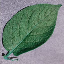

Predict: Cherry


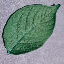

-----------------------------------
True: Potato


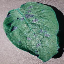

Predict: Tomato


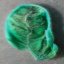

-----------------------------------
True: Potato


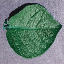

Predict: Orange


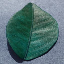

-----------------------------------
True: Potato


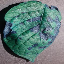

Predict: Pepper,


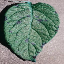

-----------------------------------
True: Potato


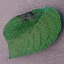

Predict: Cherry


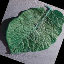

-----------------------------------
True: Potato


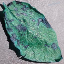

Predict: Apple


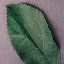

-----------------------------------
True: Potato


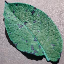

Predict: Orange


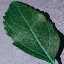

-----------------------------------
True: Potato


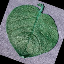

Predict: Strawberry


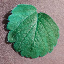

-----------------------------------
True: Potato


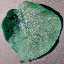

Predict: Strawberry


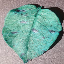

-----------------------------------
True: Raspberry


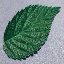

Predict: Potato


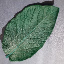

-----------------------------------
True: Raspberry


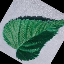

Predict: Pepper,


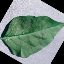

-----------------------------------
True: Raspberry


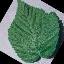

Predict: Apple


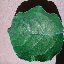

-----------------------------------
True: Raspberry


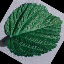

Predict: Strawberry


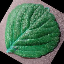

-----------------------------------
True: Raspberry


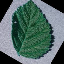

Predict: Potato


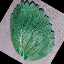

-----------------------------------
True: Raspberry


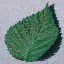

Predict: Pepper,


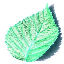

-----------------------------------
True: Raspberry


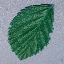

Predict: Strawberry


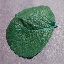

-----------------------------------
True: Raspberry


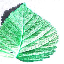

Predict: Pepper,


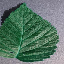

-----------------------------------
True: Raspberry


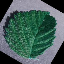

Predict: Strawberry


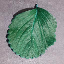

-----------------------------------
True: Raspberry


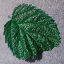

Predict: Strawberry


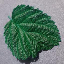

-----------------------------------
True: Raspberry


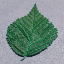

Predict: Cherry


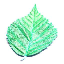

-----------------------------------
True: Raspberry


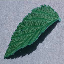

Predict: Cherry


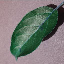

-----------------------------------
True: Raspberry


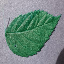

Predict: Potato


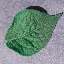

-----------------------------------
True: Raspberry


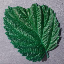

Predict: Strawberry


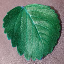

-----------------------------------
True: Raspberry


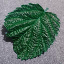

Predict: Strawberry


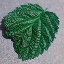

-----------------------------------
True: Raspberry


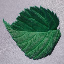

Predict: Strawberry


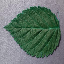

-----------------------------------
True: Raspberry


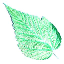

Predict: Pepper,


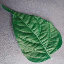

-----------------------------------
True: Raspberry


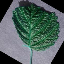

Predict: Apple


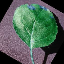

-----------------------------------
True: Raspberry


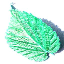

Predict: Pepper,


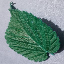

-----------------------------------
True: Raspberry


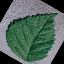

Predict: Pepper,


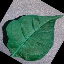

-----------------------------------
True: Raspberry


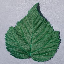

Predict: Pepper,


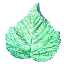

-----------------------------------
True: Raspberry


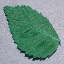

Predict: Potato


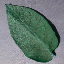

-----------------------------------
True: Raspberry


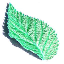

Predict: Soybean


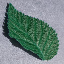

-----------------------------------
True: Raspberry


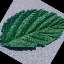

Predict: Potato


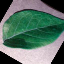

-----------------------------------
True: Raspberry


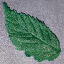

Predict: Soybean


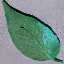

-----------------------------------
True: Raspberry


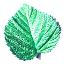

Predict: Orange


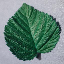

-----------------------------------
True: Raspberry


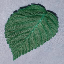

Predict: Cherry


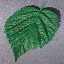

-----------------------------------
True: Raspberry


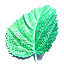

Predict: Strawberry


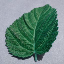

-----------------------------------
True: Raspberry


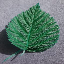

Predict: Strawberry


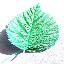

-----------------------------------
True: Raspberry


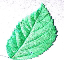

Predict: Potato


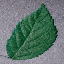

-----------------------------------
True: Raspberry


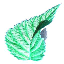

Predict: Pepper,


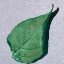

-----------------------------------
True: Raspberry


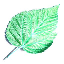

Predict: Potato


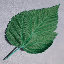

-----------------------------------
True: Raspberry


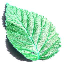

Predict: Soybean


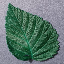

-----------------------------------
True: Raspberry


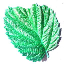

Predict: Strawberry


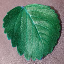

-----------------------------------
True: Raspberry


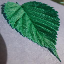

Predict: Pepper,


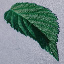

-----------------------------------
True: Soybean


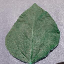

Predict: Raspberry


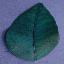

-----------------------------------
True: Soybean


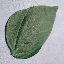

Predict: Raspberry


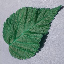

-----------------------------------
True: Soybean


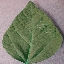

Predict: Corn


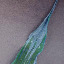

-----------------------------------
True: Soybean


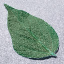

Predict: Raspberry


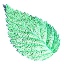

-----------------------------------
True: Soybean


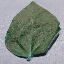

Predict: Potato


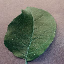

-----------------------------------
True: Soybean


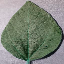

Predict: Raspberry


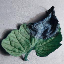

-----------------------------------
True: Soybean


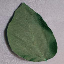

Predict: Tomato


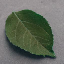

-----------------------------------
True: Soybean


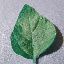

Predict: Tomato


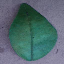

-----------------------------------
True: Soybean


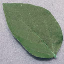

Predict: Peach


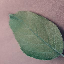

-----------------------------------
True: Soybean


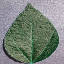

Predict: Raspberry


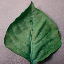

-----------------------------------
True: Soybean


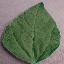

Predict: Pepper,


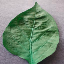

-----------------------------------
True: Soybean


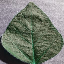

Predict: Strawberry


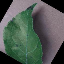

-----------------------------------
True: Soybean


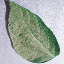

Predict: Peach


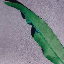

-----------------------------------
True: Soybean


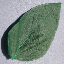

Predict: Potato


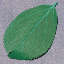

-----------------------------------
True: Soybean


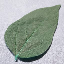

Predict: Raspberry


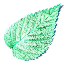

-----------------------------------
True: Soybean


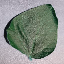

Predict: Strawberry


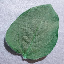

-----------------------------------
True: Soybean


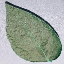

Predict: Peach


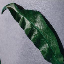

-----------------------------------
True: Soybean


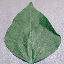

Predict: Raspberry


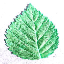

-----------------------------------
True: Soybean


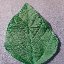

Predict: Pepper,


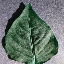

-----------------------------------
True: Soybean


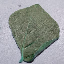

Predict: Tomato


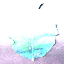

-----------------------------------
True: Soybean


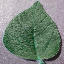

Predict: Orange


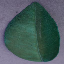

-----------------------------------
True: Soybean


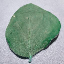

Predict: Strawberry


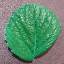

-----------------------------------
True: Soybean


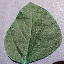

Predict: Tomato


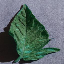

-----------------------------------
True: Soybean


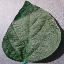

Predict: Pepper,


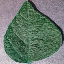

-----------------------------------
True: Soybean


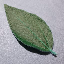

Predict: Tomato


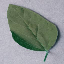

-----------------------------------
True: Soybean


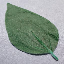

Predict: Potato


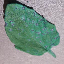

-----------------------------------
True: Soybean


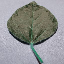

Predict: Tomato


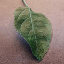

-----------------------------------
True: Soybean


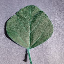

Predict: Apple


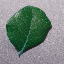

-----------------------------------
True: Soybean


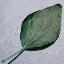

Predict: Apple


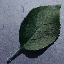

-----------------------------------
True: Soybean


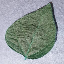

Predict: Raspberry


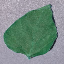

-----------------------------------
True: Soybean


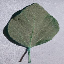

Predict: Apple


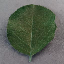

-----------------------------------
True: Soybean


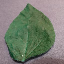

Predict: Tomato


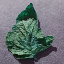

-----------------------------------
True: Soybean


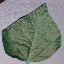

Predict: Pepper,


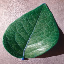

-----------------------------------
True: Soybean


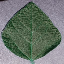

Predict: Orange


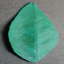

-----------------------------------
True: Soybean


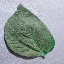

Predict: Tomato


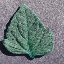

-----------------------------------
True: Soybean


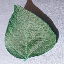

Predict: Pepper,


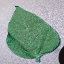

-----------------------------------
True: Soybean


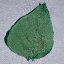

Predict: Tomato


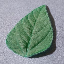

-----------------------------------
True: Soybean


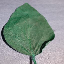

Predict: Tomato


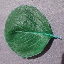

-----------------------------------
True: Soybean


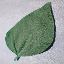

Predict: Cherry


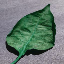

-----------------------------------
True: Soybean


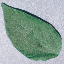

Predict: Raspberry


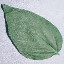

-----------------------------------
True: Soybean


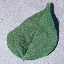

Predict: Raspberry


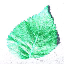

-----------------------------------
True: Soybean


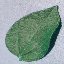

Predict: Raspberry


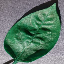

-----------------------------------
True: Soybean


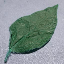

Predict: Cherry


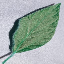

-----------------------------------
True: Soybean


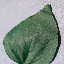

Predict: Pepper,


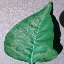

-----------------------------------
True: Soybean


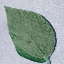

Predict: Raspberry


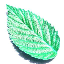

-----------------------------------
True: Soybean


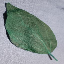

Predict: Cherry


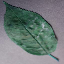

-----------------------------------
True: Soybean


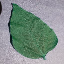

Predict: Pepper,


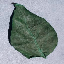

-----------------------------------
True: Soybean


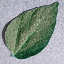

Predict: Potato


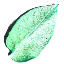

-----------------------------------
True: Soybean


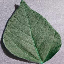

Predict: Pepper,


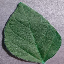

-----------------------------------
True: Soybean


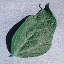

Predict: Raspberry


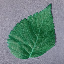

-----------------------------------
True: Soybean


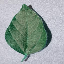

Predict: Tomato


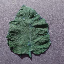

-----------------------------------
True: Soybean


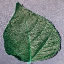

Predict: Pepper,


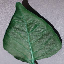

-----------------------------------
True: Soybean


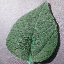

Predict: Pepper,


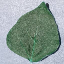

-----------------------------------
True: Soybean


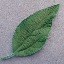

Predict: Peach


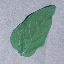

-----------------------------------
True: Soybean


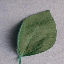

Predict: Tomato


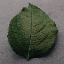

-----------------------------------
True: Soybean


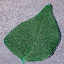

Predict: Raspberry


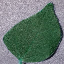

-----------------------------------
True: Soybean


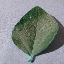

Predict: Tomato


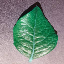

-----------------------------------
True: Soybean


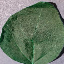

Predict: Corn


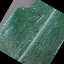

-----------------------------------
True: Soybean


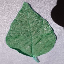

Predict: Tomato


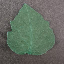

-----------------------------------
True: Soybean


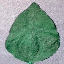

Predict: Raspberry


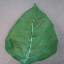

-----------------------------------
True: Soybean


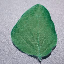

Predict: Blueberry


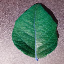

-----------------------------------
True: Soybean


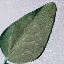

Predict: Apple


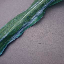

-----------------------------------
True: Soybean


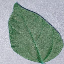

Predict: Pepper,


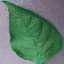

-----------------------------------
True: Soybean


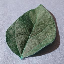

Predict: Strawberry


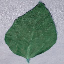

-----------------------------------
True: Soybean


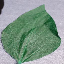

Predict: Pepper,


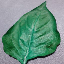

-----------------------------------
True: Soybean


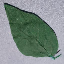

Predict: Raspberry


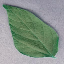

-----------------------------------
True: Soybean


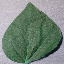

Predict: Pepper,


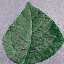

-----------------------------------
True: Soybean


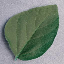

Predict: Potato


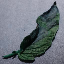

-----------------------------------
True: Soybean


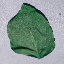

Predict: Orange


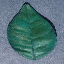

-----------------------------------
True: Soybean


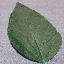

Predict: Cherry


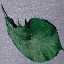

-----------------------------------
True: Soybean


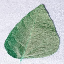

Predict: Raspberry


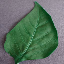

-----------------------------------
True: Soybean


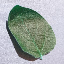

Predict: Potato


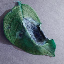

-----------------------------------
True: Soybean


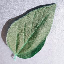

Predict: Tomato


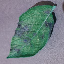

-----------------------------------
True: Soybean


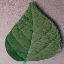

Predict: Apple


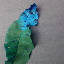

-----------------------------------
True: Soybean


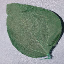

Predict: Strawberry


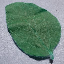

-----------------------------------
True: Soybean


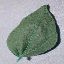

Predict: Pepper,


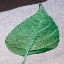

-----------------------------------
True: Squash


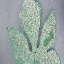

Predict: Tomato


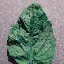

-----------------------------------
True: Squash


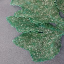

Predict: Corn


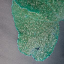

-----------------------------------
True: Squash


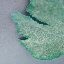

Predict: Corn


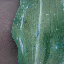

-----------------------------------
True: Squash


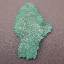

Predict: Tomato


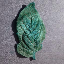

-----------------------------------
True: Squash


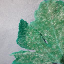

Predict: Corn


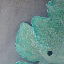

-----------------------------------
True: Squash


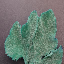

Predict: Pepper,


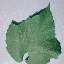

-----------------------------------
True: Squash


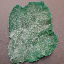

Predict: Apple


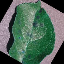

-----------------------------------
True: Squash


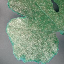

Predict: Corn


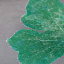

-----------------------------------
True: Squash


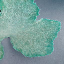

Predict: Corn


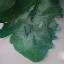

-----------------------------------
True: Squash


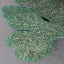

Predict: Corn


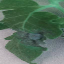

-----------------------------------
True: Squash


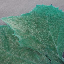

Predict: Corn


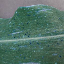

-----------------------------------
True: Squash


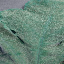

Predict: Corn


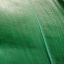

-----------------------------------
True: Squash


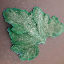

Predict: Tomato


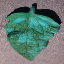

-----------------------------------
True: Squash


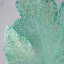

Predict: Corn


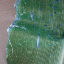

-----------------------------------
True: Squash


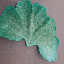

Predict: Potato


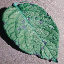

-----------------------------------
True: Squash


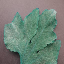

Predict: Pepper,


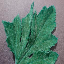

-----------------------------------
True: Squash


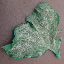

Predict: Raspberry


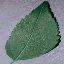

-----------------------------------
True: Squash


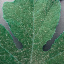

Predict: Corn


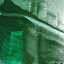

-----------------------------------
True: Squash


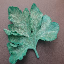

Predict: Tomato


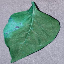

-----------------------------------
True: Squash


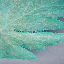

Predict: Corn


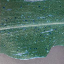

-----------------------------------
True: Squash


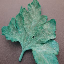

Predict: Peach


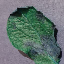

-----------------------------------
True: Squash


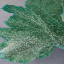

Predict: Corn


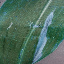

-----------------------------------
True: Squash


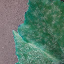

Predict: Corn


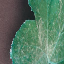

-----------------------------------
True: Squash


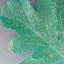

Predict: Corn


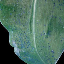

-----------------------------------
True: Squash


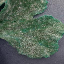

Predict: Pepper,


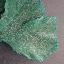

-----------------------------------
True: Squash


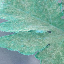

Predict: Corn


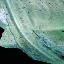

-----------------------------------
True: Squash


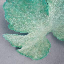

Predict: Tomato


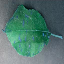

-----------------------------------
True: Squash


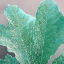

Predict: Corn


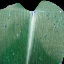

-----------------------------------
True: Strawberry


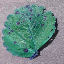

Predict: Potato


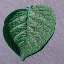

-----------------------------------
True: Strawberry


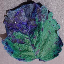

Predict: Pepper,


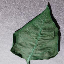

-----------------------------------
True: Strawberry


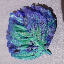

Predict: Tomato


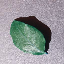

-----------------------------------
True: Strawberry


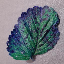

Predict: Tomato


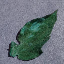

-----------------------------------
True: Strawberry


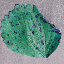

Predict: Raspberry


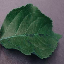

-----------------------------------
True: Strawberry


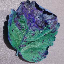

Predict: Pepper,


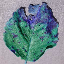

-----------------------------------
True: Strawberry


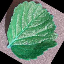

Predict: Orange


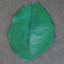

-----------------------------------
True: Strawberry


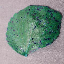

Predict: Potato


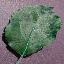

-----------------------------------
True: Strawberry


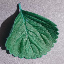

Predict: Pepper,


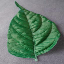

-----------------------------------
True: Strawberry


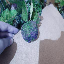

Predict: Tomato


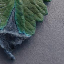

-----------------------------------
True: Strawberry


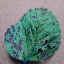

Predict: Pepper,


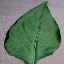

-----------------------------------
True: Strawberry


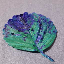

Predict: Tomato


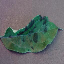

-----------------------------------
True: Strawberry


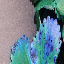

Predict: Corn


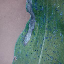

-----------------------------------
True: Strawberry


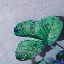

Predict: Cherry


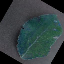

-----------------------------------
True: Strawberry


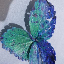

Predict: Tomato


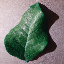

-----------------------------------
True: Strawberry


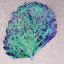

Predict: Potato


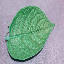

-----------------------------------
True: Strawberry


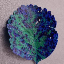

Predict: Tomato


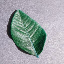

-----------------------------------
True: Strawberry


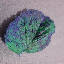

Predict: Apple


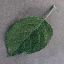

-----------------------------------
True: Strawberry


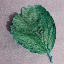

Predict: Orange


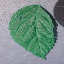

-----------------------------------
True: Strawberry


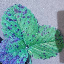

Predict: Soybean


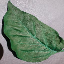

-----------------------------------
True: Strawberry


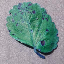

Predict: Apple


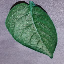

-----------------------------------
True: Strawberry


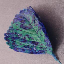

Predict: Tomato


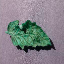

-----------------------------------
True: Strawberry


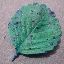

Predict: Apple


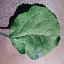

-----------------------------------
True: Strawberry


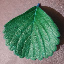

Predict: Orange


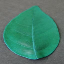

-----------------------------------
True: Strawberry


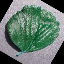

Predict: Orange


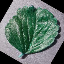

-----------------------------------
True: Strawberry


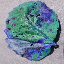

Predict: Apple


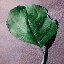

-----------------------------------
True: Strawberry


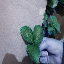

Predict: Tomato


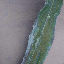

-----------------------------------
True: Strawberry


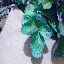

Predict: Corn


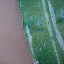

-----------------------------------
True: Strawberry


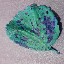

Predict: Apple


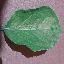

-----------------------------------
True: Strawberry


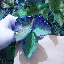

Predict: Corn


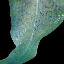

-----------------------------------
True: Strawberry


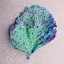

Predict: Blueberry


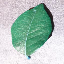

-----------------------------------
True: Strawberry


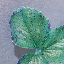

Predict: Apple


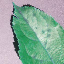

-----------------------------------
True: Strawberry


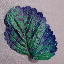

Predict: Blueberry


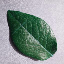

-----------------------------------
True: Strawberry


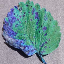

Predict: Potato


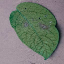

-----------------------------------
True: Strawberry


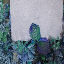

Predict: Corn


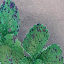

-----------------------------------
True: Strawberry


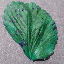

Predict: Potato


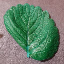

-----------------------------------
True: Strawberry


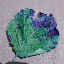

Predict: Tomato


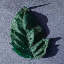

-----------------------------------
True: Strawberry


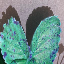

Predict: Squash


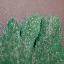

-----------------------------------
True: Strawberry


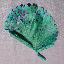

Predict: Cherry


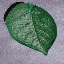

-----------------------------------
True: Strawberry


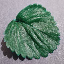

Predict: Orange


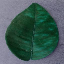

-----------------------------------
True: Strawberry


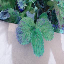

Predict: Corn


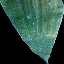

-----------------------------------
True: Strawberry


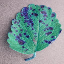

Predict: Potato


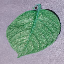

-----------------------------------
True: Strawberry


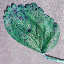

Predict: Potato


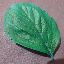

-----------------------------------
True: Tomato


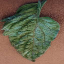

Predict: Orange


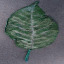

-----------------------------------
True: Tomato


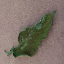

Predict: Peach


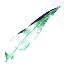

-----------------------------------
True: Tomato


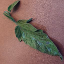

Predict: Peach


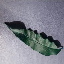

-----------------------------------
True: Tomato


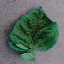

Predict: Cherry


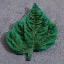

-----------------------------------
True: Tomato


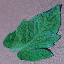

Predict: Soybean


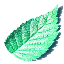

-----------------------------------
True: Tomato


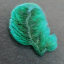

Predict: Apple


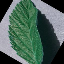

-----------------------------------
True: Tomato


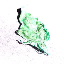

Predict: Blueberry


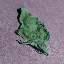

-----------------------------------
True: Tomato


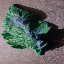

Predict: Apple


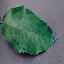

-----------------------------------
True: Tomato


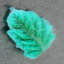

Predict: Apple


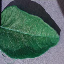

-----------------------------------
True: Tomato


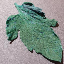

Predict: Pepper,


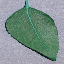

-----------------------------------
True: Tomato


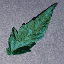

Predict: Peach


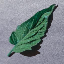

-----------------------------------
True: Tomato


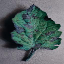

Predict: Apple


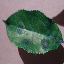

-----------------------------------
True: Tomato


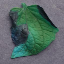

Predict: Orange


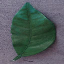

-----------------------------------
True: Tomato


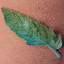

Predict: Peach


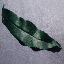

-----------------------------------
True: Tomato


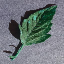

Predict: Blueberry


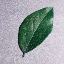

-----------------------------------
True: Tomato


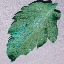

Predict: Raspberry


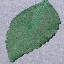

-----------------------------------
True: Tomato


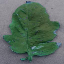

Predict: Strawberry


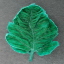

-----------------------------------
True: Tomato


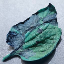

Predict: Pepper,


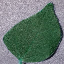

-----------------------------------
True: Tomato


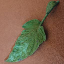

Predict: Peach


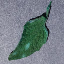

-----------------------------------
True: Tomato


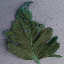

Predict: Peach


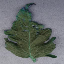

-----------------------------------
True: Tomato


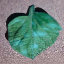

Predict: Strawberry


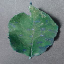

-----------------------------------
True: Tomato


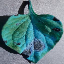

Predict: Potato


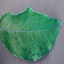

-----------------------------------
True: Tomato


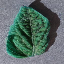

Predict: Potato


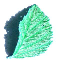

-----------------------------------
True: Tomato


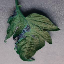

Predict: Apple


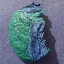

-----------------------------------
True: Tomato


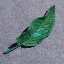

Predict: Peach


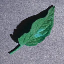

-----------------------------------
True: Tomato


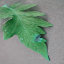

Predict: Apple


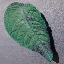

-----------------------------------
True: Tomato


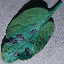

Predict: Potato


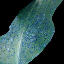

-----------------------------------
True: Tomato


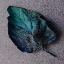

Predict: Blueberry


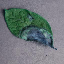

-----------------------------------


In [ ]:
predictions = []

for i in tqdm(range(len(reduced_valid_x))):
  img_shape_features = valid_shape_features[i]
  img_texture_features = valid_texture_features[i]
  img_color_features = valid_color_features[i]

  img_shape_ranking = compute_shape_ranking(train_shape_features, img_shape_features)
  img_texture_ranking = compute_texture_ranking(train_texture_features, img_texture_features)
  img_color_ranking = compute_color_ranking(train_color_features, img_color_features)

  img_tot_scores = borda_count([img_color_ranking, img_shape_ranking, img_texture_ranking], [0.1, 0.6, 0.3])
  img_tot_ranking = np.array(img_tot_scores).argsort()[::-1]
  
  #shape_result = [train_x[i] for i in img_shape_ranking]
  #show_images(img_shape_ranking, shape_result[:image_to_retrieve])
  #color_result = [train_x[i] for i in img_color_ranking]
  #show_images(img_color_ranking, color_result[:image_to_retrieve])
  #texture_result = [train_x[i] for i in img_texture_ranking]
  #show_images(img_texture_ranking, texture_result[:image_to_retrieve])

  img_result = compute_class(img_tot_scores, img_tot_ranking[:image_to_retrieve])
  img_predict = np.array(img_result).argsort()[::-1][0]
  if not class_names[img_predict] == class_names[reduced_valid_y[i]]:
    print("True: " + class_names[reduced_valid_y[i]])
    cv2_imshow(reduced_valid_x[i])
    print("Predict: " + class_names[img_predict])
    cv2_imshow(train_x[img_tot_ranking[0]])
    print("-----------------------------------")
  predictions.append(img_predict)


## Valutazione prestazioni sul validation set

Una volta classificate le diverse immagini si è effettuato il calcolo:
- dell'accuratezza -> circa 60%;
- della matrice di confusione, per valutare l'entità degli errori commessi.

Si è notato che la principale causa di errore nella classificazione è dovuta a foglie che presentano una forma molto simile fra loro, ma appartengono a classi diverse.

La maggior parte degli errori sono stati commessi sulla classe Soybean, di cui diverse immagini sono state classificate come Tomato. 

In [ ]:
from sklearn.metrics import classification_report
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

1400
1400
accuratezza per classe: [0.29 0.35 0.62 0.91 0.62 0.68 0.64 0.55 0.39 0.65 0.24 0.72 0.57 0.72]
accuratezza media: 0.5678571428571428
              precision    recall  f1-score   support

       Apple       0.45      0.29      0.35       100
   Blueberry       0.58      0.35      0.44       100
      Cherry       0.59      0.62      0.60       100
        Corn       0.76      0.91      0.83       100
       Grape       0.97      0.62      0.76       100
      Orange       0.55      0.68      0.61       100
       Peach       0.74      0.64      0.68       100
     Pepper,       0.47      0.55      0.51       100
      Potato       0.43      0.39      0.41       100
   Raspberry       0.58      0.65      0.61       100
     Soybean       0.60      0.24      0.34       100
      Squash       0.86      0.72      0.78       100
  Strawberry       0.46      0.57      0.51       100
      Tomato       0.34      0.72      0.47       100

    accuracy                           0.57 

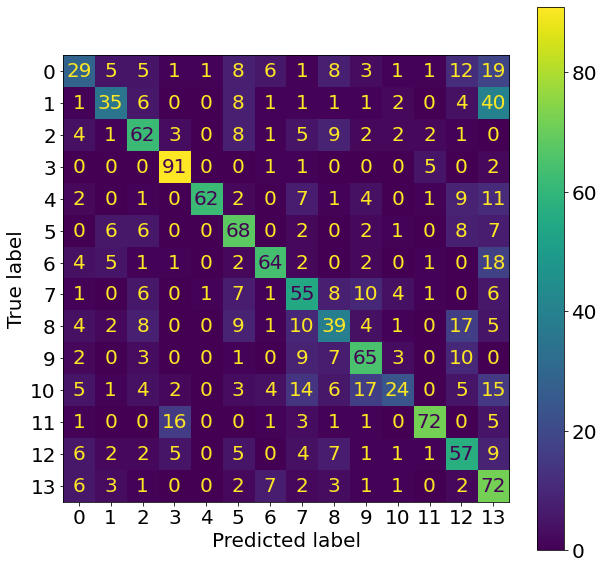

In [ ]:
print(len(reduced_valid_y))
print(len(predictions))
matrix = confusion_matrix(reduced_valid_y, predictions)
diagonal = matrix.diagonal()/matrix.sum(axis=1)
print("accuratezza per classe: " + str(diagonal))
print("accuratezza media: " + str(diagonal.sum() / len(class_names)))

print(classification_report(reduced_valid_y, predictions, target_names=class_names))

# Mostriamo la matrice di confusione
cm = confusion_matrix(reduced_valid_y, predictions, labels=list(range(len(class_names))))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(range(len(class_names))))
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax=ax)

# Predizioni sul test set

Infine, si è passati alla misura delle prestazioni sul test set
- dato che il dataset utilizzato metteva disposizione solo 33 immagini di test, si è deciso di utilizzare, per il test set, una sottoporzione del validation set
- le diverse immagini sono state classificate una ad una
 - estraendo le feature per ognuna di loro e confrontandole con quelle del training set;
 - determinando la classe di appartenenza in base alla strategia di classificazione definita precedentemente.

In [ ]:
n_for_class = 80
indices = np.array([], dtype=int)
true = np.array([], dtype=int)
for i in range(len(class_names)):
  idxs = np.array(np.where(test_y==i)[0])
  indices = np.concatenate((indices, idxs[:n_for_class]))
  true = np.concatenate((true, np.full((n_for_class, ), i)))

reduced_test_x = [test_x[i] for i in indices]
reduced_test_y = [test_y[i] for i in indices]

test_gray_images = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in reduced_test_x]
test_shape_features = [compute_shape_features(img) for img in tqdm(reduced_test_x)]
test_texture_features = [process(img, filters) for img in tqdm(test_gray_images)]
test_color_features = [compute_color_features(img) for img in tqdm(reduced_test_x)]

  0%|          | 0/1120 [00:00<?, ?it/s]

  0%|          | 0/1120 [00:00<?, ?it/s]

  0%|          | 0/1120 [00:00<?, ?it/s]

  0%|          | 0/1120 [00:00<?, ?it/s]

True: Apple


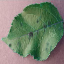

Predict: Potato


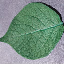

-----------------------------------
True: Apple


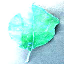

Predict: Squash


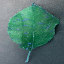

-----------------------------------
True: Apple


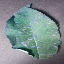

Predict: Strawberry


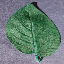

-----------------------------------
True: Apple


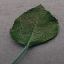

Predict: Tomato


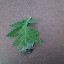

-----------------------------------
True: Apple


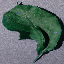

Predict: Pepper,


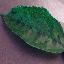

-----------------------------------
True: Apple


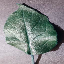

Predict: Strawberry


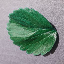

-----------------------------------
True: Apple


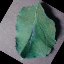

Predict: Orange


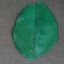

-----------------------------------
True: Apple


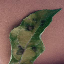

Predict: Tomato


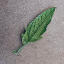

-----------------------------------
True: Apple


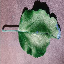

Predict: Tomato


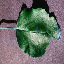

-----------------------------------
True: Apple


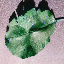

Predict: Strawberry


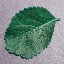

-----------------------------------
True: Apple


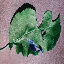

Predict: Strawberry


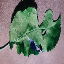

-----------------------------------
True: Apple


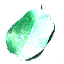

Predict: Blueberry


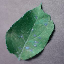

-----------------------------------
True: Apple


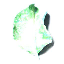

Predict: Blueberry


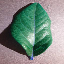

-----------------------------------
True: Apple


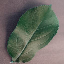

Predict: Potato


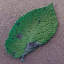

-----------------------------------
True: Apple


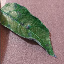

Predict: Peach


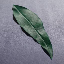

-----------------------------------
True: Apple


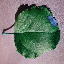

Predict: Strawberry


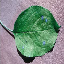

-----------------------------------
True: Apple


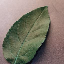

Predict: Strawberry


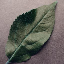

-----------------------------------
True: Apple


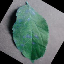

Predict: Orange


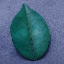

-----------------------------------
True: Apple


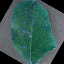

Predict: Strawberry


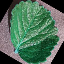

-----------------------------------
True: Apple


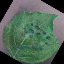

Predict: Pepper,


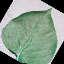

-----------------------------------
True: Apple


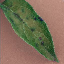

Predict: Tomato


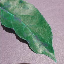

-----------------------------------
True: Apple


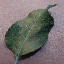

Predict: Tomato


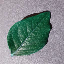

-----------------------------------
True: Apple


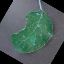

Predict: Blueberry


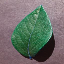

-----------------------------------
True: Apple


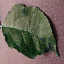

Predict: Tomato


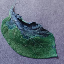

-----------------------------------
True: Apple


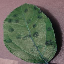

Predict: Tomato


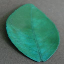

-----------------------------------
True: Apple


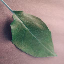

Predict: Blueberry


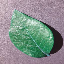

-----------------------------------
True: Apple


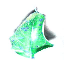

Predict: Tomato


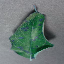

-----------------------------------
True: Apple


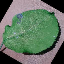

Predict: Strawberry


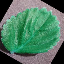

-----------------------------------
True: Apple


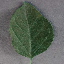

Predict: Orange


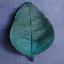

-----------------------------------
True: Apple


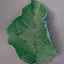

Predict: Tomato


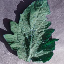

-----------------------------------
True: Apple


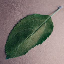

Predict: Cherry


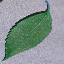

-----------------------------------
True: Apple


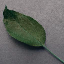

Predict: Cherry


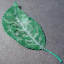

-----------------------------------
True: Apple


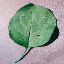

Predict: Orange


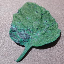

-----------------------------------
True: Apple


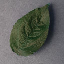

Predict: Tomato


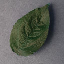

-----------------------------------
True: Apple


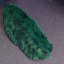

Predict: Cherry


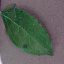

-----------------------------------
True: Apple


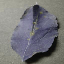

Predict: Potato


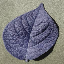

-----------------------------------
True: Apple


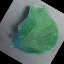

Predict: Tomato


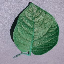

-----------------------------------
True: Apple


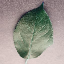

Predict: Tomato


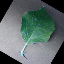

-----------------------------------
True: Apple


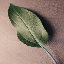

Predict: Peach


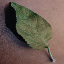

-----------------------------------
True: Apple


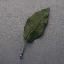

Predict: Tomato


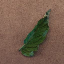

-----------------------------------
True: Apple


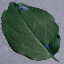

Predict: Cherry


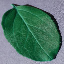

-----------------------------------
True: Apple


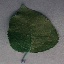

Predict: Tomato


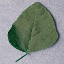

-----------------------------------
True: Apple


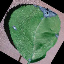

Predict: Strawberry


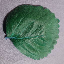

-----------------------------------
True: Apple


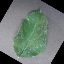

Predict: Tomato


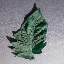

-----------------------------------
True: Apple


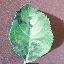

Predict: Orange


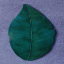

-----------------------------------
True: Apple


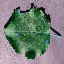

Predict: Blueberry


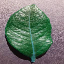

-----------------------------------
True: Apple


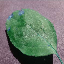

Predict: Potato


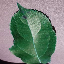

-----------------------------------
True: Apple


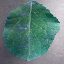

Predict: Strawberry


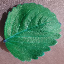

-----------------------------------
True: Apple


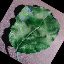

Predict: Strawberry


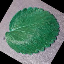

-----------------------------------
True: Apple


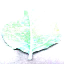

Predict: Tomato


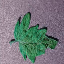

-----------------------------------
True: Apple


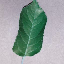

Predict: Tomato


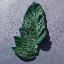

-----------------------------------
True: Apple


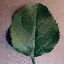

Predict: Strawberry


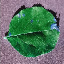

-----------------------------------
True: Apple


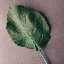

Predict: Tomato


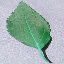

-----------------------------------
True: Apple


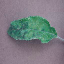

Predict: Tomato


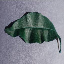

-----------------------------------
True: Apple


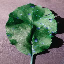

Predict: Orange


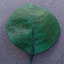

-----------------------------------
True: Apple


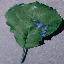

Predict: Raspberry


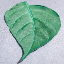

-----------------------------------
True: Blueberry


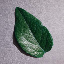

Predict: Tomato


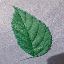

-----------------------------------
True: Blueberry


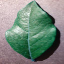

Predict: Orange


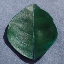

-----------------------------------
True: Blueberry


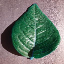

Predict: Tomato


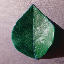

-----------------------------------
True: Blueberry


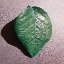

Predict: Tomato


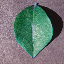

-----------------------------------
True: Blueberry


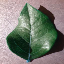

Predict: Orange


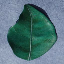

-----------------------------------
True: Blueberry


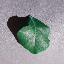

Predict: Tomato


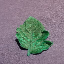

-----------------------------------
True: Blueberry


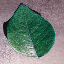

Predict: Cherry


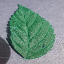

-----------------------------------
True: Blueberry


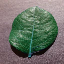

Predict: Orange


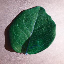

-----------------------------------
True: Blueberry


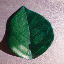

Predict: Tomato


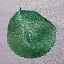

-----------------------------------
True: Blueberry


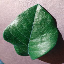

Predict: Orange


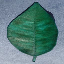

-----------------------------------
True: Blueberry


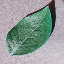

Predict: Potato


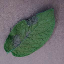

-----------------------------------
True: Blueberry


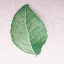

Predict: Tomato


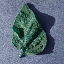

-----------------------------------
True: Blueberry


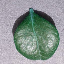

Predict: Tomato


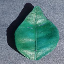

-----------------------------------
True: Blueberry


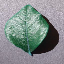

Predict: Tomato


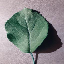

-----------------------------------
True: Blueberry


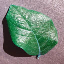

Predict: Strawberry


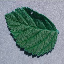

-----------------------------------
True: Blueberry


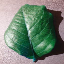

Predict: Strawberry


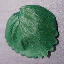

-----------------------------------
True: Blueberry


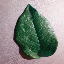

Predict: Tomato


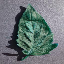

-----------------------------------
True: Blueberry


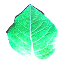

Predict: Orange


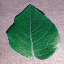

-----------------------------------
True: Blueberry


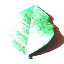

Predict: Tomato


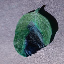

-----------------------------------
True: Blueberry


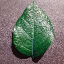

Predict: Orange


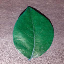

-----------------------------------
True: Blueberry


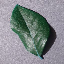

Predict: Tomato


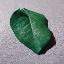

-----------------------------------
True: Blueberry


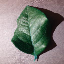

Predict: Tomato


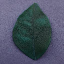

-----------------------------------
True: Blueberry


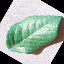

Predict: Potato


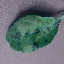

-----------------------------------
True: Blueberry


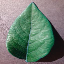

Predict: Raspberry


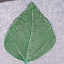

-----------------------------------
True: Blueberry


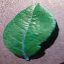

Predict: Strawberry


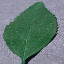

-----------------------------------
True: Blueberry


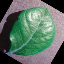

Predict: Strawberry


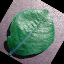

-----------------------------------
True: Blueberry


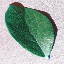

Predict: Apple


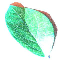

-----------------------------------
True: Blueberry


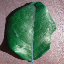

Predict: Strawberry


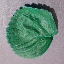

-----------------------------------
True: Blueberry


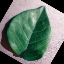

Predict: Tomato


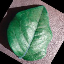

-----------------------------------
True: Blueberry


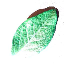

Predict: Apple


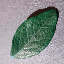

-----------------------------------
True: Blueberry


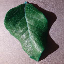

Predict: Tomato


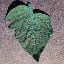

-----------------------------------
True: Blueberry


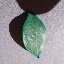

Predict: Tomato


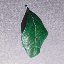

-----------------------------------
True: Blueberry


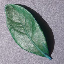

Predict: Cherry


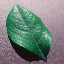

-----------------------------------
True: Blueberry


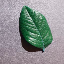

Predict: Tomato


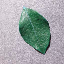

-----------------------------------
True: Blueberry


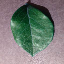

Predict: Orange


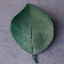

-----------------------------------
True: Blueberry


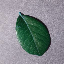

Predict: Tomato


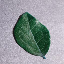

-----------------------------------
True: Blueberry


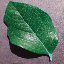

Predict: Apple


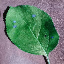

-----------------------------------
True: Blueberry


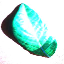

Predict: Potato


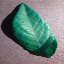

-----------------------------------
True: Blueberry


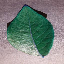

Predict: Tomato


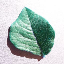

-----------------------------------
True: Cherry


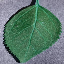

Predict: Strawberry


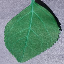

-----------------------------------
True: Cherry


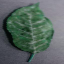

Predict: Potato


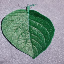

-----------------------------------
True: Cherry


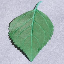

Predict: Blueberry


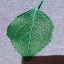

-----------------------------------
True: Cherry


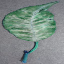

Predict: Apple


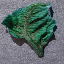

-----------------------------------
True: Cherry


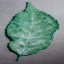

Predict: Strawberry


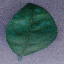

-----------------------------------
True: Cherry


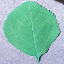

Predict: Potato


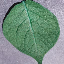

-----------------------------------
True: Cherry


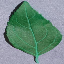

Predict: Pepper,


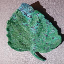

-----------------------------------
True: Cherry


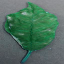

Predict: Squash


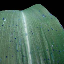

-----------------------------------
True: Cherry


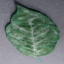

Predict: Strawberry


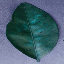

-----------------------------------
True: Cherry


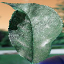

Predict: Squash


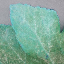

-----------------------------------
True: Cherry


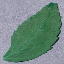

Predict: Potato


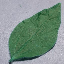

-----------------------------------
True: Cherry


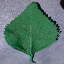

Predict: Orange


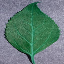

-----------------------------------
True: Cherry


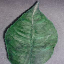

Predict: Pepper,


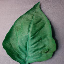

-----------------------------------
True: Cherry


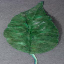

Predict: Pepper,


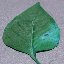

-----------------------------------
True: Cherry


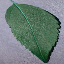

Predict: Pepper,


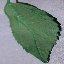

-----------------------------------
True: Cherry


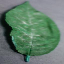

Predict: Potato


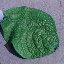

-----------------------------------
True: Cherry


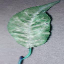

Predict: Tomato


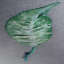

-----------------------------------
True: Cherry


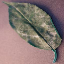

Predict: Peach


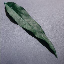

-----------------------------------
True: Cherry


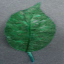

Predict: Squash


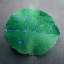

-----------------------------------
True: Cherry


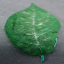

Predict: Strawberry


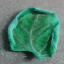

-----------------------------------
True: Cherry


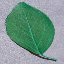

Predict: Potato


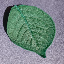

-----------------------------------
True: Cherry


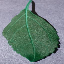

Predict: Orange


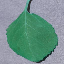

-----------------------------------
True: Cherry


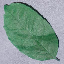

Predict: Potato


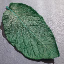

-----------------------------------
True: Cherry


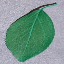

Predict: Potato


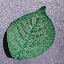

-----------------------------------
True: Cherry


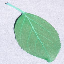

Predict: Pepper,


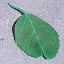

-----------------------------------
True: Cherry


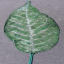

Predict: Orange


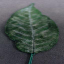

-----------------------------------
True: Cherry


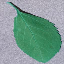

Predict: Pepper,


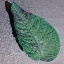

-----------------------------------
True: Cherry


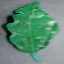

Predict: Corn


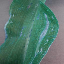

-----------------------------------
True: Cherry


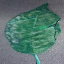

Predict: Potato


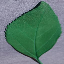

-----------------------------------
True: Cherry


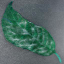

Predict: Corn


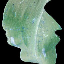

-----------------------------------
True: Cherry


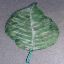

Predict: Orange


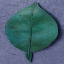

-----------------------------------
True: Corn


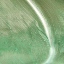

Predict: Squash


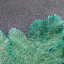

-----------------------------------
True: Corn


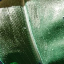

Predict: Squash


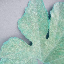

-----------------------------------
True: Corn


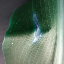

Predict: Apple


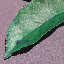

-----------------------------------
True: Corn


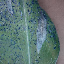

Predict: Squash


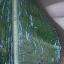

-----------------------------------
True: Corn


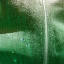

Predict: Squash


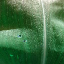

-----------------------------------
True: Corn


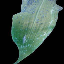

Predict: Tomato


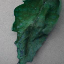

-----------------------------------
True: Corn


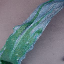

Predict: Peach


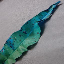

-----------------------------------
True: Corn


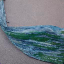

Predict: Apple


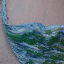

-----------------------------------
True: Corn


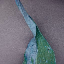

Predict: Peach


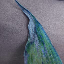

-----------------------------------
True: Corn


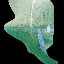

Predict: Pepper,


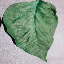

-----------------------------------
True: Grape


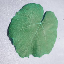

Predict: Strawberry


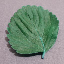

-----------------------------------
True: Grape


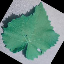

Predict: Potato


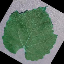

-----------------------------------
True: Grape


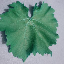

Predict: Strawberry


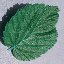

-----------------------------------
True: Grape


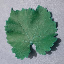

Predict: Strawberry


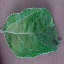

-----------------------------------
True: Grape


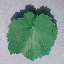

Predict: Strawberry


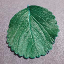

-----------------------------------
True: Grape


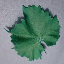

Predict: Orange


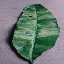

-----------------------------------
True: Grape


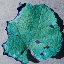

Predict: Tomato


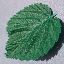

-----------------------------------
True: Grape


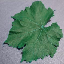

Predict: Tomato


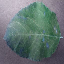

-----------------------------------
True: Grape


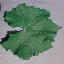

Predict: Strawberry


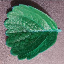

-----------------------------------
True: Grape


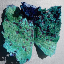

Predict: Squash


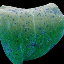

-----------------------------------
True: Grape


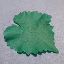

Predict: Strawberry


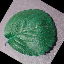

-----------------------------------
True: Grape


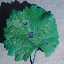

Predict: Orange


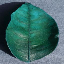

-----------------------------------
True: Grape


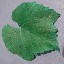

Predict: Strawberry


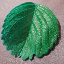

-----------------------------------
True: Grape


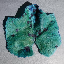

Predict: Strawberry


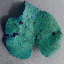

-----------------------------------
True: Grape


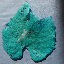

Predict: Squash


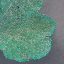

-----------------------------------
True: Grape


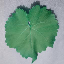

Predict: Strawberry


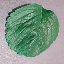

-----------------------------------
True: Grape


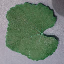

Predict: Strawberry


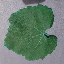

-----------------------------------
True: Grape


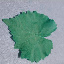

Predict: Orange


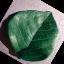

-----------------------------------
True: Grape


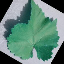

Predict: Orange


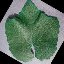

-----------------------------------
True: Grape


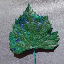

Predict: Tomato


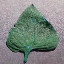

-----------------------------------
True: Grape


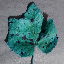

Predict: Orange


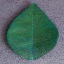

-----------------------------------
True: Grape


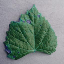

Predict: Raspberry


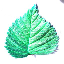

-----------------------------------
True: Grape


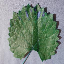

Predict: Apple


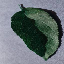

-----------------------------------
True: Grape


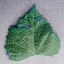

Predict: Raspberry


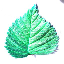

-----------------------------------
True: Grape


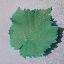

Predict: Strawberry


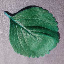

-----------------------------------
True: Orange


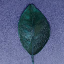

Predict: Tomato


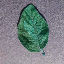

-----------------------------------
True: Orange


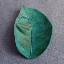

Predict: Tomato


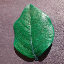

-----------------------------------
True: Orange


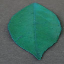

Predict: Cherry


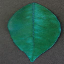

-----------------------------------
True: Orange


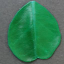

Predict: Soybean


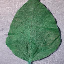

-----------------------------------
True: Orange


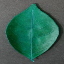

Predict: Cherry


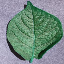

-----------------------------------
True: Orange


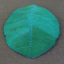

Predict: Strawberry


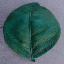

-----------------------------------
True: Orange


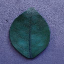

Predict: Tomato


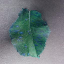

-----------------------------------
True: Orange


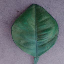

Predict: Blueberry


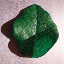

-----------------------------------
True: Orange


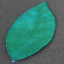

Predict: Cherry


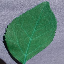

-----------------------------------
True: Orange


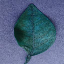

Predict: Blueberry


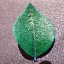

-----------------------------------
True: Orange


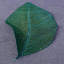

Predict: Tomato


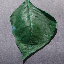

-----------------------------------
True: Orange


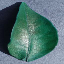

Predict: Pepper,


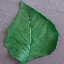

-----------------------------------
True: Orange


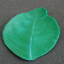

Predict: Potato


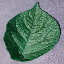

-----------------------------------
True: Orange


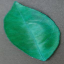

Predict: Strawberry


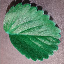

-----------------------------------
True: Orange


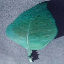

Predict: Cherry


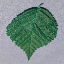

-----------------------------------
True: Orange


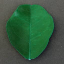

Predict: Potato


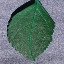

-----------------------------------
True: Orange


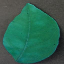

Predict: Soybean


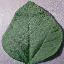

-----------------------------------
True: Orange


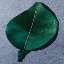

Predict: Cherry


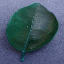

-----------------------------------
True: Orange


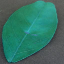

Predict: Potato


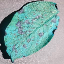

-----------------------------------
True: Orange


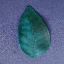

Predict: Tomato


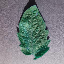

-----------------------------------
True: Orange


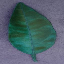

Predict: Pepper,


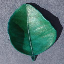

-----------------------------------
True: Orange


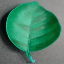

Predict: Cherry


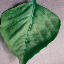

-----------------------------------
True: Orange


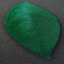

Predict: Pepper,


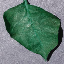

-----------------------------------
True: Orange


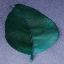

Predict: Potato


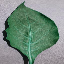

-----------------------------------
True: Orange


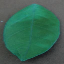

Predict: Strawberry


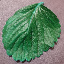

-----------------------------------
True: Peach


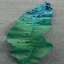

Predict: Tomato


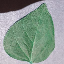

-----------------------------------
True: Peach


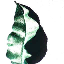

Predict: Tomato


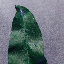

-----------------------------------
True: Peach


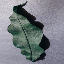

Predict: Tomato


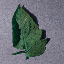

-----------------------------------
True: Peach


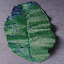

Predict: Orange


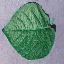

-----------------------------------
True: Peach


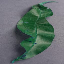

Predict: Tomato


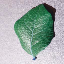

-----------------------------------
True: Peach


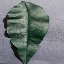

Predict: Tomato


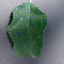

-----------------------------------
True: Peach


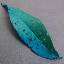

Predict: Cherry


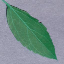

-----------------------------------
True: Peach


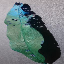

Predict: Raspberry


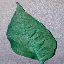

-----------------------------------
True: Peach


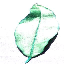

Predict: Tomato


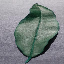

-----------------------------------
True: Peach


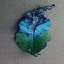

Predict: Tomato


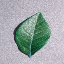

-----------------------------------
True: Peach


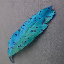

Predict: Blueberry


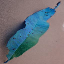

-----------------------------------
True: Peach


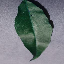

Predict: Tomato


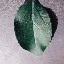

-----------------------------------
True: Peach


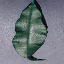

Predict: Tomato


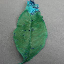

-----------------------------------
True: Peach


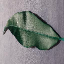

Predict: Tomato


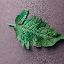

-----------------------------------
True: Peach


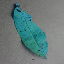

Predict: Blueberry


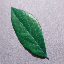

-----------------------------------
True: Peach


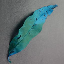

Predict: Tomato


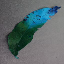

-----------------------------------
True: Peach


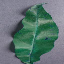

Predict: Tomato


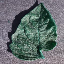

-----------------------------------
True: Peach


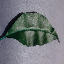

Predict: Tomato


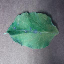

-----------------------------------
True: Peach


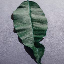

Predict: Tomato


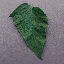

-----------------------------------
True: Peach


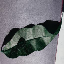

Predict: Apple


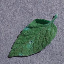

-----------------------------------
True: Peach


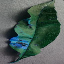

Predict: Cherry


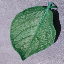

-----------------------------------
True: Peach


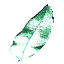

Predict: Blueberry


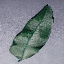

-----------------------------------
True: Peach


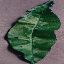

Predict: Cherry


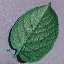

-----------------------------------
True: Peach


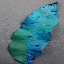

Predict: Cherry


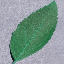

-----------------------------------
True: Peach


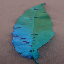

Predict: Blueberry


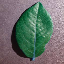

-----------------------------------
True: Peach


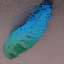

Predict: Tomato


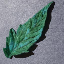

-----------------------------------
True: Peach


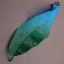

Predict: Cherry


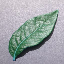

-----------------------------------
True: Peach


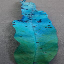

Predict: Apple


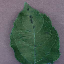

-----------------------------------
True: Peach


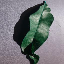

Predict: Blueberry


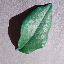

-----------------------------------
True: Peach


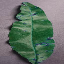

Predict: Tomato


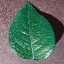

-----------------------------------
True: Peach


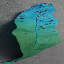

Predict: Pepper,


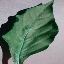

-----------------------------------
True: Peach


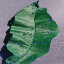

Predict: Orange


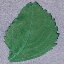

-----------------------------------
True: Peach


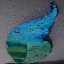

Predict: Potato


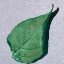

-----------------------------------
True: Pepper,


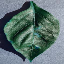

Predict: Cherry


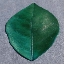

-----------------------------------
True: Pepper,


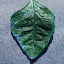

Predict: Tomato


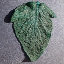

-----------------------------------
True: Pepper,


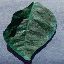

Predict: Cherry


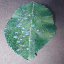

-----------------------------------
True: Pepper,


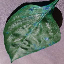

Predict: Potato


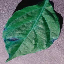

-----------------------------------
True: Pepper,


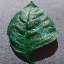

Predict: Orange


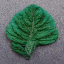

-----------------------------------
True: Pepper,


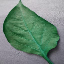

Predict: Cherry


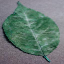

-----------------------------------
True: Pepper,


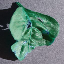

Predict: Apple


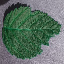

-----------------------------------
True: Pepper,


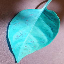

Predict: Strawberry


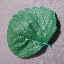

-----------------------------------
True: Pepper,


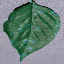

Predict: Raspberry


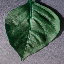

-----------------------------------
True: Pepper,


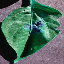

Predict: Potato


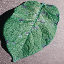

-----------------------------------
True: Pepper,


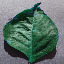

Predict: Orange


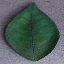

-----------------------------------
True: Pepper,


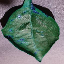

Predict: Cherry


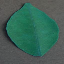

-----------------------------------
True: Pepper,


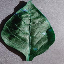

Predict: Orange


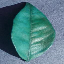

-----------------------------------
True: Pepper,


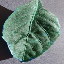

Predict: Strawberry


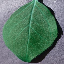

-----------------------------------
True: Pepper,


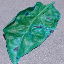

Predict: Cherry


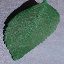

-----------------------------------
True: Pepper,


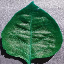

Predict: Soybean


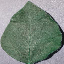

-----------------------------------
True: Pepper,


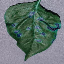

Predict: Raspberry


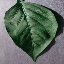

-----------------------------------
True: Pepper,


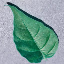

Predict: Raspberry


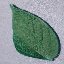

-----------------------------------
True: Pepper,


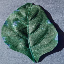

Predict: Tomato


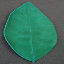

-----------------------------------
True: Pepper,


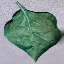

Predict: Apple


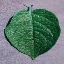

-----------------------------------
True: Pepper,


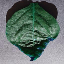

Predict: Orange


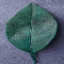

-----------------------------------
True: Pepper,


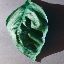

Predict: Tomato


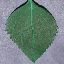

-----------------------------------
True: Pepper,


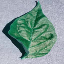

Predict: Strawberry


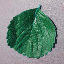

-----------------------------------
True: Pepper,


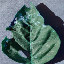

Predict: Tomato


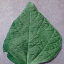

-----------------------------------
True: Pepper,


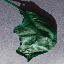

Predict: Tomato


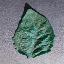

-----------------------------------
True: Pepper,


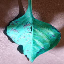

Predict: Cherry


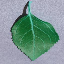

-----------------------------------
True: Pepper,


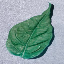

Predict: Raspberry


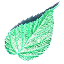

-----------------------------------
True: Pepper,


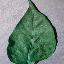

Predict: Tomato


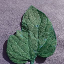

-----------------------------------
True: Pepper,


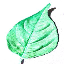

Predict: Raspberry


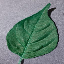

-----------------------------------
True: Pepper,


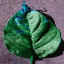

Predict: Soybean


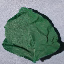

-----------------------------------
True: Pepper,


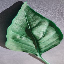

Predict: Potato


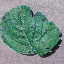

-----------------------------------
True: Pepper,


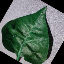

Predict: Raspberry


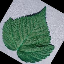

-----------------------------------
True: Pepper,


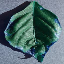

Predict: Orange


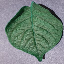

-----------------------------------
True: Pepper,


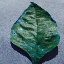

Predict: Orange


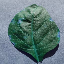

-----------------------------------
True: Pepper,


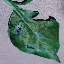

Predict: Potato


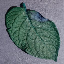

-----------------------------------
True: Pepper,


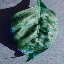

Predict: Peach


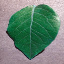

-----------------------------------
True: Pepper,


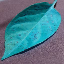

Predict: Raspberry


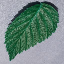

-----------------------------------
True: Pepper,


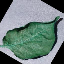

Predict: Raspberry


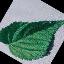

-----------------------------------
True: Pepper,


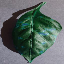

Predict: Tomato


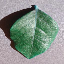

-----------------------------------
True: Pepper,


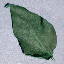

Predict: Cherry


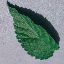

-----------------------------------
True: Pepper,


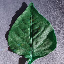

Predict: Orange


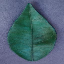

-----------------------------------
True: Pepper,


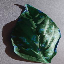

Predict: Orange


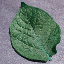

-----------------------------------
True: Potato


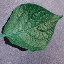

Predict: Apple


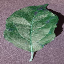

-----------------------------------
True: Potato


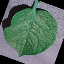

Predict: Strawberry


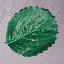

-----------------------------------
True: Potato


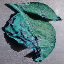

Predict: Raspberry


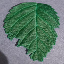

-----------------------------------
True: Potato


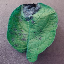

Predict: Grape


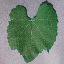

-----------------------------------
True: Potato


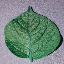

Predict: Raspberry


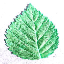

-----------------------------------
True: Potato


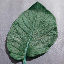

Predict: Orange


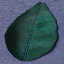

-----------------------------------
True: Potato


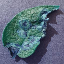

Predict: Tomato


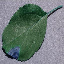

-----------------------------------
True: Potato


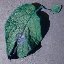

Predict: Apple


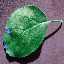

-----------------------------------
True: Potato


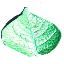

Predict: Pepper,


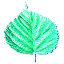

-----------------------------------
True: Potato


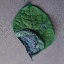

Predict: Orange


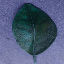

-----------------------------------
True: Potato


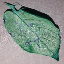

Predict: Cherry


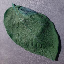

-----------------------------------
True: Potato


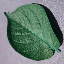

Predict: Strawberry


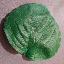

-----------------------------------
True: Potato


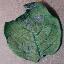

Predict: Orange


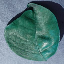

-----------------------------------
True: Potato


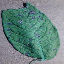

Predict: Strawberry


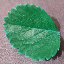

-----------------------------------
True: Potato


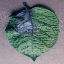

Predict: Strawberry


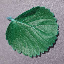

-----------------------------------
True: Potato


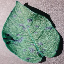

Predict: Soybean


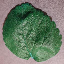

-----------------------------------
True: Potato


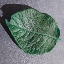

Predict: Strawberry


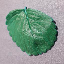

-----------------------------------
True: Potato


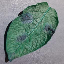

Predict: Cherry


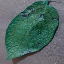

-----------------------------------
True: Potato


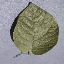

Predict: Apple


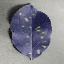

-----------------------------------
True: Potato


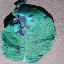

Predict: Orange


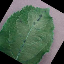

-----------------------------------
True: Potato


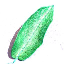

Predict: Peach


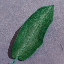

-----------------------------------
True: Potato


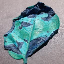

Predict: Cherry


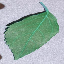

-----------------------------------
True: Potato


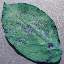

Predict: Pepper,


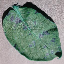

-----------------------------------
True: Potato


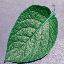

Predict: Tomato


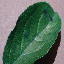

-----------------------------------
True: Potato


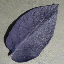

Predict: Apple


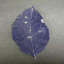

-----------------------------------
True: Potato


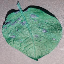

Predict: Strawberry


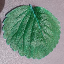

-----------------------------------
True: Potato


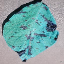

Predict: Cherry


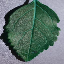

-----------------------------------
True: Potato


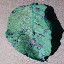

Predict: Strawberry


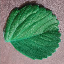

-----------------------------------
True: Potato


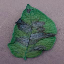

Predict: Tomato


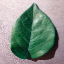

-----------------------------------
True: Potato


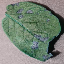

Predict: Cherry


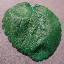

-----------------------------------
True: Potato


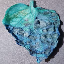

Predict: Pepper,


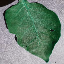

-----------------------------------
True: Potato


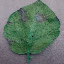

Predict: Cherry


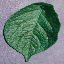

-----------------------------------
True: Potato


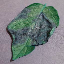

Predict: Cherry


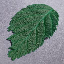

-----------------------------------
True: Potato


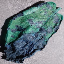

Predict: Cherry


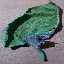

-----------------------------------
True: Potato


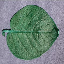

Predict: Orange


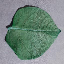

-----------------------------------
True: Potato


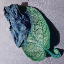

Predict: Tomato


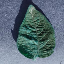

-----------------------------------
True: Potato


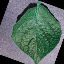

Predict: Strawberry


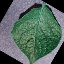

-----------------------------------
True: Potato


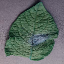

Predict: Orange


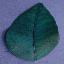

-----------------------------------
True: Potato


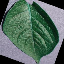

Predict: Cherry


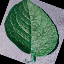

-----------------------------------
True: Potato


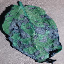

Predict: Apple


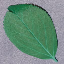

-----------------------------------
True: Potato


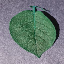

Predict: Orange


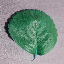

-----------------------------------
True: Potato


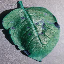

Predict: Strawberry


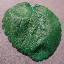

-----------------------------------
True: Potato


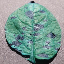

Predict: Strawberry


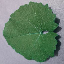

-----------------------------------
True: Potato


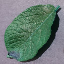

Predict: Strawberry


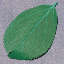

-----------------------------------
True: Potato


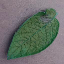

Predict: Cherry


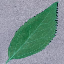

-----------------------------------
True: Potato


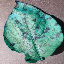

Predict: Soybean


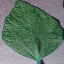

-----------------------------------
True: Raspberry


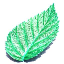

Predict: Pepper,


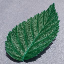

-----------------------------------
True: Raspberry


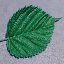

Predict: Strawberry


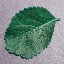

-----------------------------------
True: Raspberry


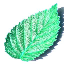

Predict: Pepper,


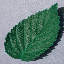

-----------------------------------
True: Raspberry


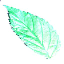

Predict: Cherry


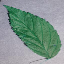

-----------------------------------
True: Raspberry


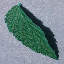

Predict: Cherry


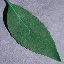

-----------------------------------
True: Raspberry


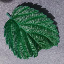

Predict: Strawberry


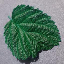

-----------------------------------
True: Raspberry


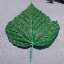

Predict: Orange


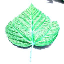

-----------------------------------
True: Raspberry


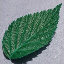

Predict: Potato


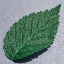

-----------------------------------
True: Raspberry


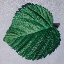

Predict: Orange


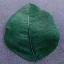

-----------------------------------
True: Raspberry


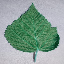

Predict: Pepper,


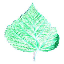

-----------------------------------
True: Raspberry


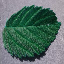

Predict: Strawberry


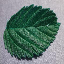

-----------------------------------
True: Raspberry


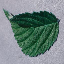

Predict: Tomato


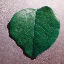

-----------------------------------
True: Raspberry


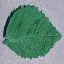

Predict: Strawberry


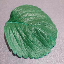

-----------------------------------
True: Raspberry


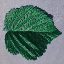

Predict: Strawberry


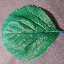

-----------------------------------
True: Raspberry


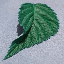

Predict: Tomato


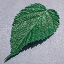

-----------------------------------
True: Raspberry


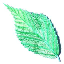

Predict: Cherry


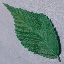

-----------------------------------
True: Raspberry


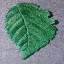

Predict: Pepper,


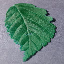

-----------------------------------
True: Raspberry


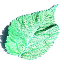

Predict: Potato


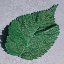

-----------------------------------
True: Raspberry


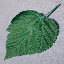

Predict: Strawberry


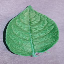

-----------------------------------
True: Raspberry


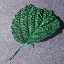

Predict: Tomato


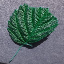

-----------------------------------
True: Raspberry


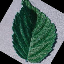

Predict: Blueberry


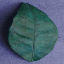

-----------------------------------
True: Raspberry


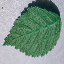

Predict: Potato


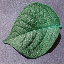

-----------------------------------
True: Raspberry


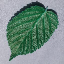

Predict: Potato


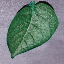

-----------------------------------
True: Raspberry


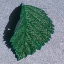

Predict: Pepper,


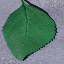

-----------------------------------
True: Raspberry


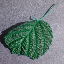

Predict: Apple


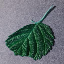

-----------------------------------
True: Raspberry


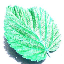

Predict: Pepper,


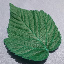

-----------------------------------
True: Raspberry


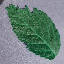

Predict: Cherry


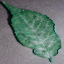

-----------------------------------
True: Soybean


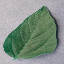

Predict: Pepper,


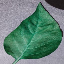

-----------------------------------
True: Soybean


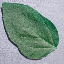

Predict: Strawberry


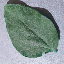

-----------------------------------
True: Soybean


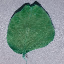

Predict: Tomato


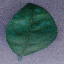

-----------------------------------
True: Soybean


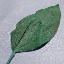

Predict: Cherry


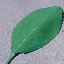

-----------------------------------
True: Soybean


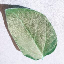

Predict: Tomato


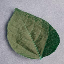

-----------------------------------
True: Soybean


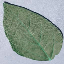

Predict: Potato


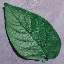

-----------------------------------
True: Soybean


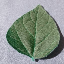

Predict: Tomato


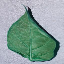

-----------------------------------
True: Soybean


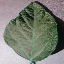

Predict: Apple


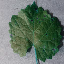

-----------------------------------
True: Soybean


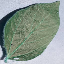

Predict: Potato


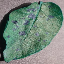

-----------------------------------
True: Soybean


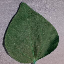

Predict: Pepper,


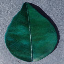

-----------------------------------
True: Soybean


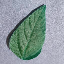

Predict: Tomato


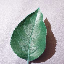

-----------------------------------
True: Soybean


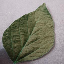

Predict: Strawberry


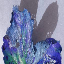

-----------------------------------
True: Soybean


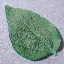

Predict: Raspberry


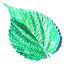

-----------------------------------
True: Soybean


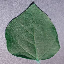

Predict: Raspberry


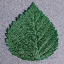

-----------------------------------
True: Soybean


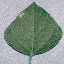

Predict: Cherry


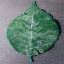

-----------------------------------
True: Soybean


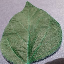

Predict: Pepper,


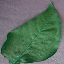

-----------------------------------
True: Soybean


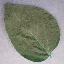

Predict: Strawberry


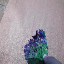

-----------------------------------
True: Soybean


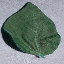

Predict: Potato


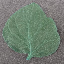

-----------------------------------
True: Soybean


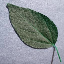

Predict: Peach


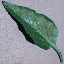

-----------------------------------
True: Soybean


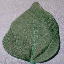

Predict: Pepper,


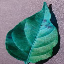

-----------------------------------
True: Soybean


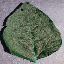

Predict: Orange


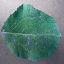

-----------------------------------
True: Soybean


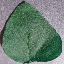

Predict: Pepper,


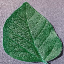

-----------------------------------
True: Soybean


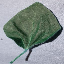

Predict: Strawberry


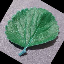

-----------------------------------
True: Soybean


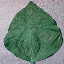

Predict: Pepper,


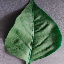

-----------------------------------
True: Soybean


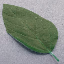

Predict: Tomato


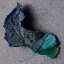

-----------------------------------
True: Soybean


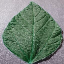

Predict: Orange


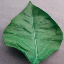

-----------------------------------
True: Soybean


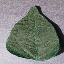

Predict: Pepper,


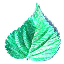

-----------------------------------
True: Soybean


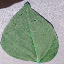

Predict: Pepper,


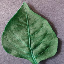

-----------------------------------
True: Soybean


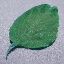

Predict: Tomato


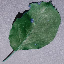

-----------------------------------
True: Soybean


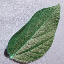

Predict: Peach


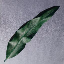

-----------------------------------
True: Soybean


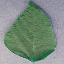

Predict: Raspberry


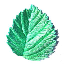

-----------------------------------
True: Soybean


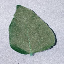

Predict: Tomato


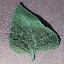

-----------------------------------
True: Soybean


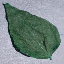

Predict: Raspberry


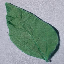

-----------------------------------
True: Soybean


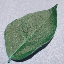

Predict: Potato


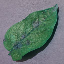

-----------------------------------
True: Soybean


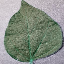

Predict: Pepper,


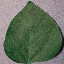

-----------------------------------
True: Soybean


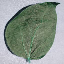

Predict: Cherry


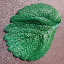

-----------------------------------
True: Soybean


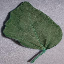

Predict: Cherry


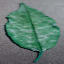

-----------------------------------
True: Soybean


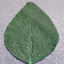

Predict: Orange


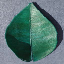

-----------------------------------
True: Soybean


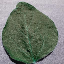

Predict: Tomato


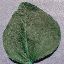

-----------------------------------
True: Soybean


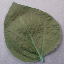

Predict: Apple


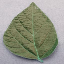

-----------------------------------
True: Soybean


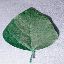

Predict: Tomato


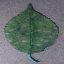

-----------------------------------
True: Soybean


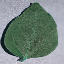

Predict: Orange


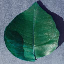

-----------------------------------
True: Soybean


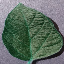

Predict: Pepper,


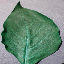

-----------------------------------
True: Soybean


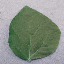

Predict: Raspberry


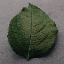

-----------------------------------
True: Soybean


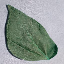

Predict: Pepper,


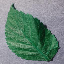

-----------------------------------
True: Soybean


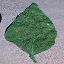

Predict: Orange


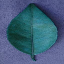

-----------------------------------
True: Soybean


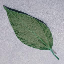

Predict: Cherry


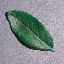

-----------------------------------
True: Soybean


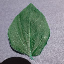

Predict: Orange


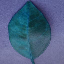

-----------------------------------
True: Soybean


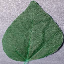

Predict: Pepper,


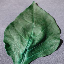

-----------------------------------
True: Squash


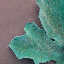

Predict: Corn


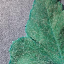

-----------------------------------
True: Squash


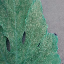

Predict: Corn


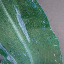

-----------------------------------
True: Squash


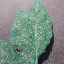

Predict: Apple


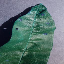

-----------------------------------
True: Squash


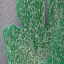

Predict: Corn


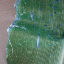

-----------------------------------
True: Squash


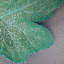

Predict: Corn


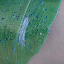

-----------------------------------
True: Squash


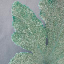

Predict: Corn


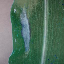

-----------------------------------
True: Squash


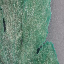

Predict: Corn


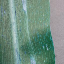

-----------------------------------
True: Squash


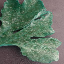

Predict: Apple


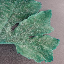

-----------------------------------
True: Squash


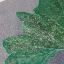

Predict: Corn


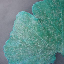

-----------------------------------
True: Squash


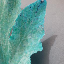

Predict: Corn


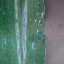

-----------------------------------
True: Squash


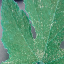

Predict: Corn


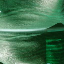

-----------------------------------
True: Squash


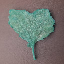

Predict: Tomato


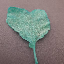

-----------------------------------
True: Squash


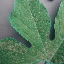

Predict: Corn


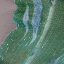

-----------------------------------
True: Squash


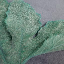

Predict: Corn


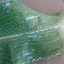

-----------------------------------
True: Squash


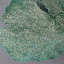

Predict: Corn


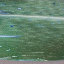

-----------------------------------
True: Squash


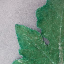

Predict: Corn


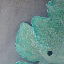

-----------------------------------
True: Squash


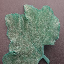

Predict: Apple


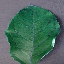

-----------------------------------
True: Squash


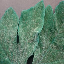

Predict: Corn


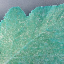

-----------------------------------
True: Strawberry


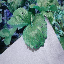

Predict: Corn


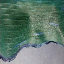

-----------------------------------
True: Strawberry


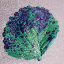

Predict: Potato


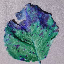

-----------------------------------
True: Strawberry


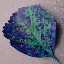

Predict: Tomato


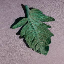

-----------------------------------
True: Strawberry


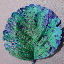

Predict: Orange


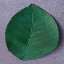

-----------------------------------
True: Strawberry


Predict: Tomato


-----------------------------------
True: Strawberry


Predict: Corn


-----------------------------------
True: Strawberry


Predict: Potato


-----------------------------------
True: Strawberry


Predict: Tomato


-----------------------------------
True: Strawberry


Predict: Corn


-----------------------------------
True: Strawberry


Predict: Tomato


-----------------------------------
True: Strawberry


Predict: Orange


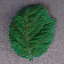

-----------------------------------
True: Strawberry


Predict: Peach


-----------------------------------
True: Strawberry


Predict: Potato


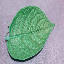

-----------------------------------
True: Strawberry


Predict: Potato


-----------------------------------
True: Strawberry


Predict: Corn


-----------------------------------
True: Strawberry


Predict: Raspberry


-----------------------------------
True: Strawberry


Predict: Corn


-----------------------------------
True: Strawberry


Predict: Blueberry


-----------------------------------
True: Strawberry


Predict: Raspberry


-----------------------------------
True: Strawberry


Predict: Raspberry


-----------------------------------
True: Strawberry


Predict: Apple


-----------------------------------
True: Strawberry


Predict: Orange


-----------------------------------
True: Strawberry


Predict: Tomato


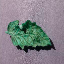

-----------------------------------
True: Strawberry


Predict: Pepper,


-----------------------------------
True: Strawberry


Predict: Potato


-----------------------------------
True: Strawberry


Predict: Potato


-----------------------------------
True: Strawberry


Predict: Orange


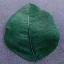

-----------------------------------
True: Strawberry


Predict: Potato


-----------------------------------
True: Strawberry


Predict: Tomato


-----------------------------------
True: Strawberry


Predict: Potato


-----------------------------------
True: Strawberry


Predict: Apple


-----------------------------------
True: Strawberry


Predict: Raspberry


-----------------------------------
True: Tomato


Predict: Pepper,


-----------------------------------
True: Tomato


Predict: Orange


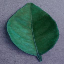

-----------------------------------
True: Tomato


Predict: Soybean


-----------------------------------
True: Tomato


Predict: Pepper,


-----------------------------------
True: Tomato


Predict: Strawberry


-----------------------------------
True: Tomato


Predict: Peach


-----------------------------------
True: Tomato


Predict: Cherry


-----------------------------------
True: Tomato


Predict: Raspberry


-----------------------------------
True: Tomato


Predict: Orange


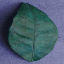

-----------------------------------
True: Tomato


Predict: Blueberry


-----------------------------------
True: Tomato


Predict: Strawberry


-----------------------------------
True: Tomato


Predict: Strawberry


-----------------------------------
True: Tomato


Predict: Blueberry


-----------------------------------
True: Tomato


Predict: Orange


-----------------------------------
True: Tomato


Predict: Potato


-----------------------------------
True: Tomato


Predict: Cherry


-----------------------------------
True: Tomato


Predict: Peach


-----------------------------------
True: Tomato


Predict: Cherry


-----------------------------------
True: Tomato


Predict: Raspberry


-----------------------------------
True: Tomato


Predict: Peach


-----------------------------------
True: Tomato


Predict: Corn


-----------------------------------
True: Tomato


Predict: Cherry


-----------------------------------
True: Tomato


Predict: Potato


-----------------------------------
True: Tomato


Predict: Raspberry


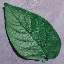

-----------------------------------
True: Tomato


Predict: Apple


-----------------------------------


In [ ]:
predictions = []
for i in tqdm(range(len(reduced_test_x))):
  img_shape_features = test_shape_features[i]
  img_texture_features = test_texture_features[i]
  img_color_features = test_color_features[i]

  img_shape_ranking = compute_shape_ranking(train_shape_features, img_shape_features)
  img_texture_ranking = compute_texture_ranking(train_texture_features, img_texture_features)
  img_color_ranking = compute_color_ranking(train_color_features, img_color_features)

  img_tot_scores = borda_count([img_color_ranking, img_shape_ranking, img_texture_ranking], [0.1, 0.6, 0.3])
  img_tot_ranking = np.array(img_tot_scores).argsort()[::-1]

  img_result = compute_class(img_tot_scores, img_tot_ranking[:image_to_retrieve])
  img_predict = np.array(img_result).argsort()[::-1][0]
  if not class_names[img_predict] == class_names[reduced_test_y[i]]:
    print("True: " + class_names[reduced_test_y[i]])
    cv2_imshow(reduced_test_x[i])
    print("Predict: " + class_names[img_predict])
    cv2_imshow(train_x[img_tot_ranking[0]])
    print("-----------------------------------")
  predictions.append(img_predict)


### Valutazione prestazioni sul test set

Una volta classificate le diverse immagini si è effettuato il calcolo:
- dell'accuratezza -> circa 60%;
- della matrice di confusione, per valutare l'entità degli errori commessi.

Si è notato che la principale causa di errore nella classificazione è dovuta a foglie che presentano una forma molto simile fra loro, ma appartengono a classi diverse.

In [ ]:
print(len(reduced_test_y))
print(len(predictions))
matrix = confusion_matrix(reduced_test_y, predictions)
diagonal = matrix.diagonal()/matrix.sum(axis=1)
print("accuratezza per classe: " + str(diagonal))
print("accuratezza media: " + str(diagonal.sum() / len(class_names)))

print(classification_report(reduced_test_y, predictions, target_names=class_names))

# Mostriamo la matrice di confusione
cm = confusion_matrix(reduced_test_y, predictions, labels=list(range(len(class_names))))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(range(len(class_names))))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(range(len(class_names))))
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax=ax)

1120
1120
accuratezza per classe: [0.3    0.5125 0.6125 0.875  0.6875 0.6875 0.5875 0.475  0.425  0.6625
 0.3875 0.775  0.6    0.6875]
accuratezza media: 0.5910714285714285
              precision    recall  f1-score   support

       Apple       0.49      0.30      0.37        80
   Blueberry       0.71      0.51      0.59        80
      Cherry       0.51      0.61      0.56        80
        Corn       0.76      0.88      0.81        80
       Grape       0.98      0.69      0.81        80
      Orange       0.50      0.69      0.58        80
       Peach       0.78      0.59      0.67        80
     Pepper,       0.51      0.47      0.49        80
      Potato       0.44      0.42      0.43        80
   Raspberry       0.66      0.66      0.66        80
     Soybean       0.82      0.39      0.53        80
      Squash       0.86      0.78      0.82        80
  Strawberry       0.44      0.60      0.51        80
      Tomato       0.37      0.69      0.48        80

    accuracy   

# Conclusioni

I risultati di classificazioni ottenuti sono buoni
- circa 60% sul validation set 
- circa 62% sul test set

Problematiche della soluzione adottata:
- la classificazione delle immagini è computazionalmente costosa e richiede diverso tempo per essere effettuata
  - le feature non sono state utilizzate per addestrare un classificatore, a causa dei limiti di memoria imposti dal framework CoLab

Possibili migliorie:
 - provare altre tecniche per l'estrazione delle feature
  - usare altri spazi colore;
  - il contorno delle foglie, tramite individuazione degli edge;
  - Bag Of Words e tecniche pasate su i keypoint.
 - provare ad aumentare la dimensione delle immagini;
 - migliorare la tecnica di aquisizione della forma;
 - sfruttare per la computazione della classe la GPU;
